# Data Mining 21/22 Final Project
Implementation of a Deep Convolutional GAN for generating [Ukiyo-e](https://en.wikipedia.org/wiki/Ukiyo-e)


![img](https://upload.wikimedia.org/wikipedia/commons/thumb/a/a5/Tsunami_by_hokusai_19th_century.jpg/350px-Tsunami_by_hokusai_19th_century.jpg)

# Basic Imports
Using mainly:
- Pytorch
- Numpy
- Tensorflow (for image loading)
- Sklearn (for results)


In [1]:
# Basic Imports
import numpy as np
import pandas as pd
import random
import os
import matplotlib.pyplot as plt
import tensorflow as tf

import pandas as pd

import torch
import torchvision

import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import random_split

import torchvision.models as models
import torchvision.transforms as transforms

from torchvision.utils import make_grid
from torchvision.datasets.folder import default_loader

from PIL import Image

from tensorflow.keras.preprocessing.image import load_img, img_to_array

from sklearn.metrics import classification_report, log_loss, accuracy_score
from sklearn.model_selection import train_test_split

from tqdm.notebook import tqdm

%matplotlib inline

# Set random seed for reproducibility
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
train_dir = '../input/the-metropolitan-museum-of-art-ukiyoe-dataset/images'

# Parameters definition
Choose values for:
  #### Dataset Parameters
- **Batch Size** (loaded from dataset)
- **Image Size** (both 128 or 64, best performances with 64)
- **Normalization Stats**

#### Training Parameters
- **Beta 1** for Adam Optimizator
- **Loss Criterion**
- **Learning Rate**
- **Training Epochs** (at least 200 suggested)

In [4]:
# Dataset Parameters
batch_size = 128
image_size = (64,64)
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# Training Paramters
beta1 = 0.5
criterion = F.binary_cross_entropy
lr = 0.0002
epochs = 450

# Data loading 
Using a redefinition of pytorch Dataset class to pre-load images. The dataset used is [The Metropolitan Museum of Art Ukiyoe Dataset](https://www.kaggle.com/kengoichiki/the-metropolitan-museum-of-art-ukiyoe-dataset)

In [5]:
names=[]
for file in os.listdir(train_dir):
    names+=[file]
print(names)
print(len(names))

['Hishikawa_Moronobu', 'Utagawa_Yoshiiku', 'Kawanabe_Kyosai', 'Toyohara_Kunichika', 'Toshusai_Sharaku', 'Ippitsusai_Buncho', 'Torii_Kiyonaga', 'Kano_Tanyu', 'Kitao_Shigemasa', 'Torii_Kiyomitsu', 'Torii_Kiyonobu', 'Nishikawa_Sukenobu', 'Katsukawa_Shunsho', 'Utagawa_Hiroshige_II', 'Utagawa_Hiroshige', 'Katsukawa_Shuncho', 'Katsukawa_Shunei', 'Utagawa_Kuniyoshi', 'Katsukawa_Shunko', 'Ryuryukyo_Shinsai', 'Tsukioka_Yoshitoshi', 'Utagawa_Sadahide', 'Utagawa_Yoshitora', 'Okumura_Masanobu', 'Ike_Taiga', 'Isoda_Koryusai', 'Utagawa_Kunisada', 'Utagawa_Toyoharu', 'Ishikawa_Toyonobu', 'Utagawa_Toyohiro', 'Torii_Kiyomasu', 'Yoshu_Chikanobu', 'Utagawa_Toyokuni_I', 'Seki_Shuko', 'Chobunsai_Eishi', 'Katsushika_Hokusai', 'Kuwagata_Keisai', 'Keisai_Eisen', 'Sakai_Hoitsu', 'Yashima_Gakutei', 'Shibata_Zeshin', 'Eiraku_Hozen', 'Teisai_Hokuba', 'Totoya_Hokkei', 'Kano_Shoun', 'Watanabe_Seitei', 'Kitagawa_Utamaro', 'Suzuki_Harunobu', 'Utagawa_Yoshikazu', 'Kubo_Shunman']
50


In [6]:
transform_ds = transforms.Compose([
                                   transforms.Resize(image_size),
                                   transforms.CenterCrop(image_size),
                                   transforms.ToTensor(),
                                   transforms.Normalize(*stats)
                                   ])

train_ds = torchvision.datasets.ImageFolder(root=train_dir,
                                     transform=transform_ds)

In [7]:
classes_dict = train_ds.class_to_idx
reverse_cd = {v: k for k, v in classes_dict.items()}
reverse_cd

{0: 'Chobunsai_Eishi',
 1: 'Eiraku_Hozen',
 2: 'Hishikawa_Moronobu',
 3: 'Ike_Taiga',
 4: 'Ippitsusai_Buncho',
 5: 'Ishikawa_Toyonobu',
 6: 'Isoda_Koryusai',
 7: 'Kano_Shoun',
 8: 'Kano_Tanyu',
 9: 'Katsukawa_Shuncho',
 10: 'Katsukawa_Shunei',
 11: 'Katsukawa_Shunko',
 12: 'Katsukawa_Shunsho',
 13: 'Katsushika_Hokusai',
 14: 'Kawanabe_Kyosai',
 15: 'Keisai_Eisen',
 16: 'Kitagawa_Utamaro',
 17: 'Kitao_Shigemasa',
 18: 'Kubo_Shunman',
 19: 'Kuwagata_Keisai',
 20: 'Nishikawa_Sukenobu',
 21: 'Okumura_Masanobu',
 22: 'Ryuryukyo_Shinsai',
 23: 'Sakai_Hoitsu',
 24: 'Seki_Shuko',
 25: 'Shibata_Zeshin',
 26: 'Suzuki_Harunobu',
 27: 'Teisai_Hokuba',
 28: 'Torii_Kiyomasu',
 29: 'Torii_Kiyomitsu',
 30: 'Torii_Kiyonaga',
 31: 'Torii_Kiyonobu',
 32: 'Toshusai_Sharaku',
 33: 'Totoya_Hokkei',
 34: 'Toyohara_Kunichika',
 35: 'Tsukioka_Yoshitoshi',
 36: 'Utagawa_Hiroshige',
 37: 'Utagawa_Hiroshige_II',
 38: 'Utagawa_Kunisada',
 39: 'Utagawa_Kuniyoshi',
 40: 'Utagawa_Sadahide',
 41: 'Utagawa_Toyoharu',
 

In [8]:
# Custom Ds for npz
class MyDataset(Dataset):
    def __init__(self, data, targets, transform=None):
        self.data = data
        self.targets = torch.LongTensor(targets)
        self.transform = transform
        
    def __getitem__(self, index):
        x = self.data[index]
        y = self.targets[index]
        
        if self.transform:
            x = Image.fromarray(self.data[index].astype(np.uint8))
            x = self.transform(x)
        
        return x, y
    
    def __len__(self):
        return len(self.data)

In [9]:
data_path = "data.npy"

# Data Augmentation
Necessary for improving generator performances by applying:
- Random Vertical Flip
- Color Jitter
- Random Resize Crop
- Random Posterize
to every image

In [10]:
from skimage.transform import rotate
from skimage.util import random_noise
from skimage.filters import gaussian
from scipy import ndimage

In [11]:
if not os.path.exists(data_path):
    # Pre-load all data 
    dataset = []
    labels  = []
    count=0
    print("Loading dataset...")
    for file in tqdm(names):
        path=os.path.join(train_dir,file)
        for im in os.listdir(path):
            image=load_img(os.path.join(path,im), grayscale=False, color_mode='rgb',target_size=image_size)
            image=img_to_array(image, dtype='uint8')
            
            ## AHUGmentation!
            dataset.append(image)
            image_base = Image.fromarray(image.astype(np.uint8))
            
            image = transforms.RandomVerticalFlip(p=1)(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            image = transforms.ColorJitter(brightness=.2, hue=.0)(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            image = transforms.RandomResizedCrop(size=(64, 64))(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            image = transforms.RandomPosterize(bits=2)(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            # Insert Labels
            for j in range(5):
                labels.append(classes_dict[file])
           
            count+=1

    with open(data_path, 'wb') as f:
        # Save progresses
        np.save(f, np.asarray(dataset))
        np.save(f, np.asarray(labels))
else:
    with open(data_path, 'rb') as f:
        # Load progresses to avoid extra computation
        dataset = list(np.load(f))
        labels  = list(np.load(f))


Loading dataset...


  0%|          | 0/50 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/PIL/Image.py:2858: DecompressionBombWarning: Image size (96709923 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


In [12]:
dataset = np.asarray(dataset)
print(dataset[0].shape)

ds_2 = MyDataset(dataset,labels,transform=transform_ds)
print("Dataset elements number:",len(ds_2))

train_dl = DataLoader(ds_2, batch_size, shuffle=True, num_workers=2, pin_memory=True)

(64, 64, 3)
Dataset elements number: 20090


In [13]:
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

Min and max pixel values: -0.64705884 1.0
torch.Size([3, 64, 64])
Author: Katsukawa_Shunsho


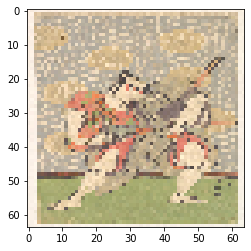

In [14]:
images,label = ds_2[3400]

print("Min and max pixel values:", images.numpy().min(), images.numpy().max())
print(images.size())
print("Author:",reverse_cd[label.item()])

plt.imshow(denorm(images).permute(1,2,0))

In [15]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

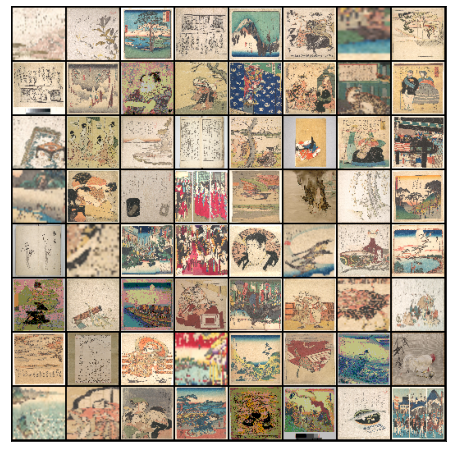

In [16]:
show_batch(train_dl)

In [17]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [18]:
device = get_default_device()
device

device(type='cuda')

In [19]:
train_dl = DeviceDataLoader(train_dl, device)

# Model definition
Deep Convolutional Generative Adversarial Network defined according to [this paper](https://arxiv.org/pdf/1511.06434.pdf%5D)
![img](https://miro.medium.com/max/777/1*rdXKdyfNjorzP10ZA3yNmQ.png)

*Generator model*

## Discriminator

In [20]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    #nn.Dropout(p=0.1),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    #nn.Dropout(p=0.1),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    #nn.Dropout(p=0.1),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    #nn.Dropout(p=0.1),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    nn.Dropout(p=0.3),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

discriminator__128 = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 128, kernel_size=4, stride=4, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(128, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    nn.Dropout(p=0.3),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

In [21]:
! pip install torchsummary
# Model Summary
from torchsummary import summary

In [22]:
discriminator = to_device(discriminator, device)

summary(discriminator,(3,image_size[0],image_size[1]))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
       BatchNorm2d-2           [-1, 64, 32, 32]             128
         LeakyReLU-3           [-1, 64, 32, 32]               0
            Conv2d-4          [-1, 128, 16, 16]         131,072
       BatchNorm2d-5          [-1, 128, 16, 16]             256
         LeakyReLU-6          [-1, 128, 16, 16]               0
            Conv2d-7            [-1, 256, 8, 8]         524,288
       BatchNorm2d-8            [-1, 256, 8, 8]             512
         LeakyReLU-9            [-1, 256, 8, 8]               0
           Conv2d-10            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-11            [-1, 512, 4, 4]           1,024
        LeakyReLU-12            [-1, 512, 4, 4]               0
           Conv2d-13              [-1, 1, 1, 1]           8,192
          Dropout-14              [-1, 

## Generator

In [23]:
latent_size = 100

In [24]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    #nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    #nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    #nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    #nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)

generator__128 = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(128, 3, kernel_size=8, stride=4, padding=2, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)

In [25]:
generator = to_device(generator, device)

summary(generator,(latent_size,1,1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

torch.Size([128, 3, 64, 64])


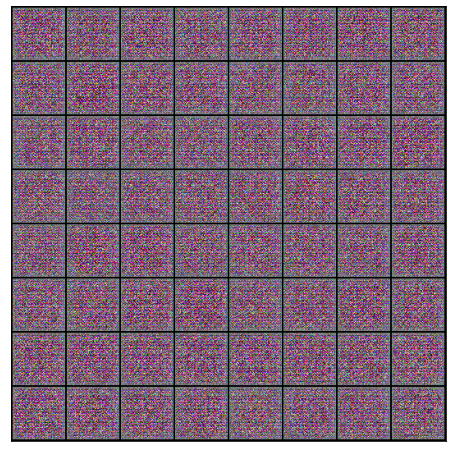

In [26]:
# Quick Test
xb = torch.randn(batch_size, latent_size, 1, 1).to(device) # random latent tensors
fake_images = generator(xb)
print(fake_images.shape)
show_images(fake_images.to("cpu"))

# Training
Training the models in order to generate some meaningful data using as many techniques as required from [this paper](https://arxiv.org/abs/1606.03498), like dropout for the disciminator, different values of learning rate and normalization.

In [27]:
import torch.optim as optim
import torchvision.utils as vutils
import torchvision.datasets as dset

In [28]:
import random

In [29]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    #real_targets = torch.FloatTensor(real_images.size(0), 1).uniform_(0.7, 1.2).to(device) # sLOW DOWN Disc?
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = criterion(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = criterion(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

In [30]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)
    
    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = criterion(preds, targets)
    
    # Update generator weights
    loss.backward()
    opt_g.step()
    
    return loss.item()

In [31]:
from torchvision.utils import save_image

In [32]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [33]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(denorm(fake_images.cpu().detach()), nrow=8).permute(1, 2, 0))

## Image generated with noise
Images generated before training for reference

In [34]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

Saving generated-images-0000.png


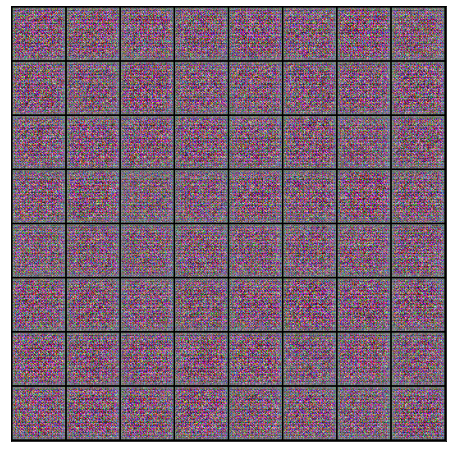

In [35]:
save_samples(0, fixed_latent)

In [36]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
    
    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            loss_g = train_generator(opt_g)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=False)
    
    return losses_g, losses_d, real_scores, fake_scores

## Model Fitting
Actual training section

In [37]:
%%time
history = fit(epochs,lr)

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [1/450], loss_g: 2.9205, loss_d: 0.6159, real_score: 0.7311, fake_score: 0.2019
Saving generated-images-0001.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [2/450], loss_g: 2.5129, loss_d: 0.9764, real_score: 0.7842, fake_score: 0.4841
Saving generated-images-0002.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [3/450], loss_g: 5.0257, loss_d: 1.1170, real_score: 0.7420, fake_score: 0.5080
Saving generated-images-0003.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [4/450], loss_g: 2.9541, loss_d: 0.7755, real_score: 0.7065, fake_score: 0.2865
Saving generated-images-0004.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [5/450], loss_g: 2.6948, loss_d: 0.6694, real_score: 0.7765, fake_score: 0.2827
Saving generated-images-0005.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [6/450], loss_g: 2.4163, loss_d: 0.7238, real_score: 0.6791, fake_score: 0.2158
Saving generated-images-0006.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [7/450], loss_g: 2.4949, loss_d: 0.6334, real_score: 0.7181, fake_score: 0.1969
Saving generated-images-0007.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [8/450], loss_g: 3.0664, loss_d: 0.5590, real_score: 0.7515, fake_score: 0.1756
Saving generated-images-0008.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [9/450], loss_g: 3.3761, loss_d: 0.7074, real_score: 0.7473, fake_score: 0.2907
Saving generated-images-0009.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [10/450], loss_g: 3.6772, loss_d: 0.6963, real_score: 0.7676, fake_score: 0.2960
Saving generated-images-0010.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [11/450], loss_g: 5.8280, loss_d: 0.6375, real_score: 0.7089, fake_score: 0.1702
Saving generated-images-0011.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [12/450], loss_g: 7.0958, loss_d: 0.7761, real_score: 0.5863, fake_score: 0.1139
Saving generated-images-0012.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [13/450], loss_g: 5.9707, loss_d: 0.5853, real_score: 0.7823, fake_score: 0.2221
Saving generated-images-0013.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [14/450], loss_g: 6.4005, loss_d: 1.2557, real_score: 0.4383, fake_score: 0.1408
Saving generated-images-0014.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [15/450], loss_g: 3.9080, loss_d: 0.6247, real_score: 0.7458, fake_score: 0.2189
Saving generated-images-0015.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [16/450], loss_g: 3.1195, loss_d: 0.7011, real_score: 0.6933, fake_score: 0.2137
Saving generated-images-0016.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [17/450], loss_g: 5.5910, loss_d: 0.8901, real_score: 0.7785, fake_score: 0.4108
Saving generated-images-0017.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [18/450], loss_g: 4.9148, loss_d: 0.6181, real_score: 0.7714, fake_score: 0.2440
Saving generated-images-0018.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [19/450], loss_g: 5.2107, loss_d: 0.6711, real_score: 0.7899, fake_score: 0.2983
Saving generated-images-0019.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [20/450], loss_g: 3.4463, loss_d: 0.5433, real_score: 0.7895, fake_score: 0.1931
Saving generated-images-0020.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [21/450], loss_g: 6.0763, loss_d: 0.6655, real_score: 0.6656, fake_score: 0.1570
Saving generated-images-0021.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [22/450], loss_g: 3.1886, loss_d: 0.5256, real_score: 0.8185, fake_score: 0.2170
Saving generated-images-0022.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [23/450], loss_g: 3.0453, loss_d: 0.6379, real_score: 0.7100, fake_score: 0.1875
Saving generated-images-0023.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [24/450], loss_g: 5.1540, loss_d: 0.6607, real_score: 0.8157, fake_score: 0.3102
Saving generated-images-0024.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [25/450], loss_g: 2.8780, loss_d: 1.2051, real_score: 0.4629, fake_score: 0.1294
Saving generated-images-0025.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [26/450], loss_g: 6.0799, loss_d: 0.5518, real_score: 0.7286, fake_score: 0.1346
Saving generated-images-0026.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [27/450], loss_g: 5.3831, loss_d: 0.6612, real_score: 0.6925, fake_score: 0.1610
Saving generated-images-0027.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [28/450], loss_g: 2.7081, loss_d: 0.5738, real_score: 0.7803, fake_score: 0.2117
Saving generated-images-0028.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [29/450], loss_g: 4.6610, loss_d: 0.4600, real_score: 0.8206, fake_score: 0.1674
Saving generated-images-0029.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [30/450], loss_g: 4.7885, loss_d: 0.5876, real_score: 0.8262, fake_score: 0.2609
Saving generated-images-0030.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [31/450], loss_g: 4.5466, loss_d: 0.4585, real_score: 0.8081, fake_score: 0.1592
Saving generated-images-0031.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [32/450], loss_g: 6.4609, loss_d: 0.4393, real_score: 0.8544, fake_score: 0.1780
Saving generated-images-0032.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [33/450], loss_g: 3.8627, loss_d: 0.4870, real_score: 0.8050, fake_score: 0.1655
Saving generated-images-0033.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [34/450], loss_g: 3.8351, loss_d: 0.4871, real_score: 0.8225, fake_score: 0.1910
Saving generated-images-0034.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [35/450], loss_g: 6.4115, loss_d: 0.5913, real_score: 0.8449, fake_score: 0.2720
Saving generated-images-0035.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [36/450], loss_g: 4.7128, loss_d: 0.5316, real_score: 0.8197, fake_score: 0.2152
Saving generated-images-0036.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [37/450], loss_g: 2.5275, loss_d: 0.5140, real_score: 0.7719, fake_score: 0.1575
Saving generated-images-0037.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [38/450], loss_g: 3.2057, loss_d: 0.6624, real_score: 0.6712, fake_score: 0.1516
Saving generated-images-0038.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [39/450], loss_g: 6.4731, loss_d: 0.6005, real_score: 0.8647, fake_score: 0.3087
Saving generated-images-0039.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [40/450], loss_g: 3.5652, loss_d: 0.5118, real_score: 0.7659, fake_score: 0.1467
Saving generated-images-0040.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [41/450], loss_g: 2.5282, loss_d: 0.5760, real_score: 0.7549, fake_score: 0.1818
Saving generated-images-0041.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [42/450], loss_g: 4.7790, loss_d: 0.5355, real_score: 0.7996, fake_score: 0.1980
Saving generated-images-0042.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [43/450], loss_g: 3.3159, loss_d: 0.4938, real_score: 0.8161, fake_score: 0.1832
Saving generated-images-0043.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [44/450], loss_g: 2.5966, loss_d: 1.1699, real_score: 0.4609, fake_score: 0.1603
Saving generated-images-0044.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [45/450], loss_g: 4.8486, loss_d: 1.2803, real_score: 0.6128, fake_score: 0.2650
Saving generated-images-0045.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [46/450], loss_g: 3.9820, loss_d: 0.5355, real_score: 0.7772, fake_score: 0.1767
Saving generated-images-0046.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [47/450], loss_g: 2.4842, loss_d: 0.6357, real_score: 0.7129, fake_score: 0.1742
Saving generated-images-0047.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [48/450], loss_g: 3.6520, loss_d: 0.6150, real_score: 0.7302, fake_score: 0.1795
Saving generated-images-0048.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [49/450], loss_g: 4.2078, loss_d: 0.5540, real_score: 0.8155, fake_score: 0.2329
Saving generated-images-0049.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [50/450], loss_g: 2.1028, loss_d: 0.5850, real_score: 0.7916, fake_score: 0.2321
Saving generated-images-0050.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [51/450], loss_g: 4.8437, loss_d: 0.4390, real_score: 0.8761, fake_score: 0.2123
Saving generated-images-0051.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [52/450], loss_g: 5.8739, loss_d: 0.5763, real_score: 0.8112, fake_score: 0.2405
Saving generated-images-0052.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [53/450], loss_g: 4.6529, loss_d: 0.4171, real_score: 0.8416, fake_score: 0.1509
Saving generated-images-0053.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [54/450], loss_g: 3.1206, loss_d: 0.5707, real_score: 0.8296, fake_score: 0.2593
Saving generated-images-0054.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [55/450], loss_g: 5.3248, loss_d: 0.5111, real_score: 0.8394, fake_score: 0.2046
Saving generated-images-0055.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [56/450], loss_g: 11.0295, loss_d: 1.3984, real_score: 0.8681, fake_score: 0.6298
Saving generated-images-0056.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [57/450], loss_g: 0.9278, loss_d: 0.7518, real_score: 0.6312, fake_score: 0.1514
Saving generated-images-0057.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [58/450], loss_g: 3.4137, loss_d: 0.6987, real_score: 0.6929, fake_score: 0.1992
Saving generated-images-0058.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [59/450], loss_g: 5.3677, loss_d: 0.6453, real_score: 0.7962, fake_score: 0.2620
Saving generated-images-0059.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [60/450], loss_g: 8.7319, loss_d: 1.0612, real_score: 0.8686, fake_score: 0.4956
Saving generated-images-0060.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [61/450], loss_g: 6.4156, loss_d: 0.6987, real_score: 0.8103, fake_score: 0.3187
Saving generated-images-0061.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [62/450], loss_g: 3.1077, loss_d: 0.5123, real_score: 0.7593, fake_score: 0.1460
Saving generated-images-0062.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [63/450], loss_g: 5.5958, loss_d: 0.5901, real_score: 0.8557, fake_score: 0.2755
Saving generated-images-0063.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [64/450], loss_g: 4.8845, loss_d: 0.4894, real_score: 0.7817, fake_score: 0.1450
Saving generated-images-0064.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [65/450], loss_g: 5.8993, loss_d: 0.5162, real_score: 0.7567, fake_score: 0.1416
Saving generated-images-0065.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [66/450], loss_g: 3.3367, loss_d: 0.5185, real_score: 0.8135, fake_score: 0.1979
Saving generated-images-0066.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [67/450], loss_g: 3.4405, loss_d: 0.5027, real_score: 0.8080, fake_score: 0.1902
Saving generated-images-0067.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [68/450], loss_g: 5.8750, loss_d: 0.6515, real_score: 0.8311, fake_score: 0.2891
Saving generated-images-0068.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [69/450], loss_g: 2.7641, loss_d: 0.4977, real_score: 0.7696, fake_score: 0.1445
Saving generated-images-0069.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [70/450], loss_g: 5.5862, loss_d: 0.5805, real_score: 0.8067, fake_score: 0.2387
Saving generated-images-0070.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [71/450], loss_g: 2.2960, loss_d: 0.4663, real_score: 0.8198, fake_score: 0.1740
Saving generated-images-0071.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [72/450], loss_g: 4.3449, loss_d: 0.5045, real_score: 0.8410, fake_score: 0.2164
Saving generated-images-0072.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [73/450], loss_g: 7.2574, loss_d: 0.6484, real_score: 0.8696, fake_score: 0.3188
Saving generated-images-0073.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [74/450], loss_g: 3.6130, loss_d: 0.4657, real_score: 0.8222, fake_score: 0.1654
Saving generated-images-0074.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [75/450], loss_g: 4.9330, loss_d: 0.5021, real_score: 0.8302, fake_score: 0.2039
Saving generated-images-0075.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [76/450], loss_g: 3.2275, loss_d: 0.5403, real_score: 0.7808, fake_score: 0.1908
Saving generated-images-0076.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [77/450], loss_g: 3.1456, loss_d: 0.5790, real_score: 0.7628, fake_score: 0.1909
Saving generated-images-0077.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [78/450], loss_g: 5.6097, loss_d: 0.4805, real_score: 0.8011, fake_score: 0.1539
Saving generated-images-0078.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [79/450], loss_g: 4.4212, loss_d: 0.4670, real_score: 0.8481, fake_score: 0.1922
Saving generated-images-0079.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [80/450], loss_g: 3.6558, loss_d: 0.5272, real_score: 0.7997, fake_score: 0.1953
Saving generated-images-0080.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [81/450], loss_g: 4.3223, loss_d: 1.1476, real_score: 0.4817, fake_score: 0.1531
Saving generated-images-0081.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [82/450], loss_g: 2.9475, loss_d: 0.5126, real_score: 0.7743, fake_score: 0.1572
Saving generated-images-0082.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [83/450], loss_g: 4.6901, loss_d: 0.7491, real_score: 0.6315, fake_score: 0.1447
Saving generated-images-0083.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [84/450], loss_g: 3.5240, loss_d: 0.5250, real_score: 0.8197, fake_score: 0.2100
Saving generated-images-0084.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [85/450], loss_g: 4.3777, loss_d: 0.4065, real_score: 0.8772, fake_score: 0.1750
Saving generated-images-0085.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [86/450], loss_g: 13.1843, loss_d: 1.7330, real_score: 0.8606, fake_score: 0.6650
Saving generated-images-0086.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [87/450], loss_g: 3.7722, loss_d: 0.4242, real_score: 0.8419, fake_score: 0.1560
Saving generated-images-0087.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [88/450], loss_g: 4.4064, loss_d: 0.6227, real_score: 0.7709, fake_score: 0.2160
Saving generated-images-0088.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [89/450], loss_g: 3.8711, loss_d: 0.4190, real_score: 0.8763, fake_score: 0.1921
Saving generated-images-0089.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [90/450], loss_g: 4.3536, loss_d: 0.4255, real_score: 0.8442, fake_score: 0.1588
Saving generated-images-0090.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [91/450], loss_g: 4.3700, loss_d: 0.4587, real_score: 0.8142, fake_score: 0.1601
Saving generated-images-0091.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [92/450], loss_g: 3.8244, loss_d: 0.4514, real_score: 0.7981, fake_score: 0.1348
Saving generated-images-0092.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [93/450], loss_g: 4.9393, loss_d: 0.4640, real_score: 0.8334, fake_score: 0.1722
Saving generated-images-0093.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [94/450], loss_g: 8.5724, loss_d: 0.8071, real_score: 0.8904, fake_score: 0.3964
Saving generated-images-0094.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [95/450], loss_g: 2.9936, loss_d: 0.4705, real_score: 0.8263, fake_score: 0.1771
Saving generated-images-0095.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [96/450], loss_g: 6.0302, loss_d: 0.4575, real_score: 0.8511, fake_score: 0.1848
Saving generated-images-0096.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [97/450], loss_g: 2.4704, loss_d: 0.5367, real_score: 0.7991, fake_score: 0.1999
Saving generated-images-0097.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [98/450], loss_g: 2.6784, loss_d: 0.4658, real_score: 0.8290, fake_score: 0.1766
Saving generated-images-0098.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [99/450], loss_g: 3.8905, loss_d: 0.4804, real_score: 0.8459, fake_score: 0.1964
Saving generated-images-0099.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [100/450], loss_g: 4.8344, loss_d: 0.5021, real_score: 0.7855, fake_score: 0.1572
Saving generated-images-0100.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [101/450], loss_g: 4.5123, loss_d: 0.4332, real_score: 0.8519, fake_score: 0.1736
Saving generated-images-0101.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [102/450], loss_g: 4.1526, loss_d: 0.4713, real_score: 0.8218, fake_score: 0.1722
Saving generated-images-0102.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [103/450], loss_g: 4.4799, loss_d: 0.4438, real_score: 0.7939, fake_score: 0.1190
Saving generated-images-0103.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [104/450], loss_g: 3.8575, loss_d: 0.4632, real_score: 0.8088, fake_score: 0.1507
Saving generated-images-0104.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [105/450], loss_g: 4.4135, loss_d: 0.6052, real_score: 0.7163, fake_score: 0.1446
Saving generated-images-0105.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [106/450], loss_g: 3.0034, loss_d: 0.4577, real_score: 0.8039, fake_score: 0.1463
Saving generated-images-0106.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [107/450], loss_g: 5.0048, loss_d: 0.3847, real_score: 0.8378, fake_score: 0.1223
Saving generated-images-0107.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [108/450], loss_g: 4.3935, loss_d: 0.4486, real_score: 0.8648, fake_score: 0.1981
Saving generated-images-0108.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [109/450], loss_g: 3.7412, loss_d: 0.5014, real_score: 0.8208, fake_score: 0.1935
Saving generated-images-0109.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [110/450], loss_g: 3.3866, loss_d: 0.4486, real_score: 0.8219, fake_score: 0.1505
Saving generated-images-0110.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [111/450], loss_g: 4.3719, loss_d: 0.5936, real_score: 0.7618, fake_score: 0.1758
Saving generated-images-0111.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [112/450], loss_g: 3.7817, loss_d: 0.4985, real_score: 0.8309, fake_score: 0.1984
Saving generated-images-0112.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [113/450], loss_g: 3.7927, loss_d: 0.4284, real_score: 0.8186, fake_score: 0.1355
Saving generated-images-0113.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [114/450], loss_g: 3.6464, loss_d: 0.4615, real_score: 0.8066, fake_score: 0.1504
Saving generated-images-0114.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [115/450], loss_g: 3.9978, loss_d: 0.5029, real_score: 0.8483, fake_score: 0.2179
Saving generated-images-0115.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [116/450], loss_g: 2.2383, loss_d: 0.5517, real_score: 0.7381, fake_score: 0.1422
Saving generated-images-0116.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [117/450], loss_g: 3.5646, loss_d: 0.3758, real_score: 0.8820, fake_score: 0.1559
Saving generated-images-0117.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [118/450], loss_g: 4.8820, loss_d: 0.4774, real_score: 0.8321, fake_score: 0.1840
Saving generated-images-0118.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [119/450], loss_g: 4.4298, loss_d: 0.4738, real_score: 0.8123, fake_score: 0.1625
Saving generated-images-0119.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [120/450], loss_g: 5.9528, loss_d: 0.4143, real_score: 0.8294, fake_score: 0.1305
Saving generated-images-0120.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [121/450], loss_g: 3.2581, loss_d: 0.4465, real_score: 0.8640, fake_score: 0.1898
Saving generated-images-0121.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [122/450], loss_g: 4.5987, loss_d: 0.4851, real_score: 0.8254, fake_score: 0.1834
Saving generated-images-0122.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [123/450], loss_g: 4.8769, loss_d: 0.5272, real_score: 0.8093, fake_score: 0.1951
Saving generated-images-0123.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [124/450], loss_g: 4.5574, loss_d: 0.3885, real_score: 0.8599, fake_score: 0.1456
Saving generated-images-0124.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [125/450], loss_g: 4.5725, loss_d: 0.5347, real_score: 0.8144, fake_score: 0.1998
Saving generated-images-0125.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [126/450], loss_g: 3.9893, loss_d: 0.4490, real_score: 0.8509, fake_score: 0.1829
Saving generated-images-0126.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [127/450], loss_g: 3.3825, loss_d: 0.4261, real_score: 0.8203, fake_score: 0.1359
Saving generated-images-0127.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [128/450], loss_g: 4.0734, loss_d: 0.3847, real_score: 0.8311, fake_score: 0.1152
Saving generated-images-0128.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [129/450], loss_g: 2.6419, loss_d: 0.7130, real_score: 0.8360, fake_score: 0.3040
Saving generated-images-0129.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [130/450], loss_g: 4.4841, loss_d: 0.4751, real_score: 0.8467, fake_score: 0.1920
Saving generated-images-0130.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [131/450], loss_g: 3.9146, loss_d: 0.5316, real_score: 0.8008, fake_score: 0.1918
Saving generated-images-0131.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [132/450], loss_g: 5.9814, loss_d: 0.5868, real_score: 0.8225, fake_score: 0.2440
Saving generated-images-0132.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [133/450], loss_g: 5.2277, loss_d: 0.4286, real_score: 0.8403, fake_score: 0.1597
Saving generated-images-0133.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [134/450], loss_g: 4.8241, loss_d: 0.5070, real_score: 0.7907, fake_score: 0.1633
Saving generated-images-0134.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [135/450], loss_g: 4.0959, loss_d: 0.4465, real_score: 0.8300, fake_score: 0.1622
Saving generated-images-0135.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [136/450], loss_g: 3.8520, loss_d: 0.5059, real_score: 0.7846, fake_score: 0.1581
Saving generated-images-0136.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [137/450], loss_g: 4.2199, loss_d: 0.4105, real_score: 0.8159, fake_score: 0.1204
Saving generated-images-0137.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [138/450], loss_g: 3.8670, loss_d: 0.3687, real_score: 0.8665, fake_score: 0.1386
Saving generated-images-0138.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [139/450], loss_g: 5.8710, loss_d: 0.4678, real_score: 0.8226, fake_score: 0.1650
Saving generated-images-0139.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [140/450], loss_g: 4.4122, loss_d: 0.4731, real_score: 0.7997, fake_score: 0.1525
Saving generated-images-0140.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [141/450], loss_g: 5.0572, loss_d: 0.4771, real_score: 0.8526, fake_score: 0.1970
Saving generated-images-0141.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [142/450], loss_g: 5.2270, loss_d: 0.4615, real_score: 0.7936, fake_score: 0.1341
Saving generated-images-0142.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [143/450], loss_g: 4.8513, loss_d: 0.4216, real_score: 0.8564, fake_score: 0.1624
Saving generated-images-0143.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [144/450], loss_g: 4.7740, loss_d: 0.3708, real_score: 0.8874, fake_score: 0.1604
Saving generated-images-0144.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [145/450], loss_g: 4.5026, loss_d: 0.3963, real_score: 0.8550, fake_score: 0.1476
Saving generated-images-0145.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [146/450], loss_g: 4.7235, loss_d: 0.4968, real_score: 0.8187, fake_score: 0.1836
Saving generated-images-0146.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [147/450], loss_g: 3.8969, loss_d: 0.4146, real_score: 0.8401, fake_score: 0.1422
Saving generated-images-0147.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [148/450], loss_g: 3.8511, loss_d: 0.4930, real_score: 0.7825, fake_score: 0.1504
Saving generated-images-0148.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [149/450], loss_g: 4.8486, loss_d: 0.4518, real_score: 0.8235, fake_score: 0.1569
Saving generated-images-0149.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [150/450], loss_g: 10.3004, loss_d: 0.6224, real_score: 0.7024, fake_score: 0.1447
Saving generated-images-0150.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [151/450], loss_g: 5.8154, loss_d: 0.6319, real_score: 0.7441, fake_score: 0.1837
Saving generated-images-0151.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [152/450], loss_g: 4.5206, loss_d: 0.4481, real_score: 0.8477, fake_score: 0.1760
Saving generated-images-0152.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [153/450], loss_g: 5.3833, loss_d: 0.4997, real_score: 0.8266, fake_score: 0.2005
Saving generated-images-0153.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [154/450], loss_g: 4.0261, loss_d: 0.4206, real_score: 0.8532, fake_score: 0.1607
Saving generated-images-0154.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [155/450], loss_g: 4.8143, loss_d: 0.4921, real_score: 0.8705, fake_score: 0.2263
Saving generated-images-0155.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [156/450], loss_g: 4.5273, loss_d: 0.4751, real_score: 0.7880, fake_score: 0.1378
Saving generated-images-0156.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [157/450], loss_g: 4.3988, loss_d: 0.4229, real_score: 0.8305, fake_score: 0.1409
Saving generated-images-0157.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [158/450], loss_g: 3.8842, loss_d: 0.4315, real_score: 0.8485, fake_score: 0.1652
Saving generated-images-0158.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [159/450], loss_g: 4.6762, loss_d: 0.4068, real_score: 0.8581, fake_score: 0.1621
Saving generated-images-0159.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [160/450], loss_g: 4.5632, loss_d: 0.4225, real_score: 0.8335, fake_score: 0.1409
Saving generated-images-0160.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [161/450], loss_g: 3.2468, loss_d: 0.5243, real_score: 0.7616, fake_score: 0.1506
Saving generated-images-0161.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [162/450], loss_g: 4.1442, loss_d: 0.4892, real_score: 0.8201, fake_score: 0.1796
Saving generated-images-0162.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [163/450], loss_g: 3.9206, loss_d: 0.5169, real_score: 0.7994, fake_score: 0.1779
Saving generated-images-0163.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [164/450], loss_g: 3.4962, loss_d: 0.4362, real_score: 0.8142, fake_score: 0.1340
Saving generated-images-0164.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [165/450], loss_g: 4.9030, loss_d: 0.4157, real_score: 0.8352, fake_score: 0.1437
Saving generated-images-0165.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [166/450], loss_g: 8.3524, loss_d: 0.4427, real_score: 0.8215, fake_score: 0.1486
Saving generated-images-0166.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [167/450], loss_g: 4.8492, loss_d: 0.4529, real_score: 0.8534, fake_score: 0.1861
Saving generated-images-0167.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [168/450], loss_g: 5.4897, loss_d: 0.4459, real_score: 0.7982, fake_score: 0.1180
Saving generated-images-0168.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [169/450], loss_g: 3.2595, loss_d: 0.5375, real_score: 0.7758, fake_score: 0.1670
Saving generated-images-0169.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [170/450], loss_g: 3.5579, loss_d: 0.4430, real_score: 0.8146, fake_score: 0.1426
Saving generated-images-0170.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [171/450], loss_g: 5.4943, loss_d: 0.5032, real_score: 0.8553, fake_score: 0.2226
Saving generated-images-0171.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [172/450], loss_g: 6.1724, loss_d: 0.4346, real_score: 0.8571, fake_score: 0.1766
Saving generated-images-0172.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [173/450], loss_g: 3.6979, loss_d: 0.4155, real_score: 0.8346, fake_score: 0.1436
Saving generated-images-0173.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [174/450], loss_g: 5.8724, loss_d: 0.4986, real_score: 0.8178, fake_score: 0.1822
Saving generated-images-0174.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [175/450], loss_g: 4.1212, loss_d: 0.4904, real_score: 0.8129, fake_score: 0.1756
Saving generated-images-0175.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [176/450], loss_g: 3.9157, loss_d: 0.4555, real_score: 0.8441, fake_score: 0.1796
Saving generated-images-0176.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [177/450], loss_g: 4.9056, loss_d: 0.4428, real_score: 0.8344, fake_score: 0.1565
Saving generated-images-0177.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [178/450], loss_g: 4.6148, loss_d: 0.5111, real_score: 0.8186, fake_score: 0.1919
Saving generated-images-0178.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [179/450], loss_g: 7.1275, loss_d: 0.4422, real_score: 0.8474, fake_score: 0.1690
Saving generated-images-0179.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [180/450], loss_g: 5.9306, loss_d: 0.5046, real_score: 0.8107, fake_score: 0.1807
Saving generated-images-0180.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [181/450], loss_g: 7.8369, loss_d: 0.4192, real_score: 0.8260, fake_score: 0.1303
Saving generated-images-0181.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [182/450], loss_g: 6.6857, loss_d: 0.4853, real_score: 0.8254, fake_score: 0.1794
Saving generated-images-0182.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [183/450], loss_g: 4.3417, loss_d: 0.5409, real_score: 0.8024, fake_score: 0.1992
Saving generated-images-0183.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [184/450], loss_g: 8.7771, loss_d: 0.4350, real_score: 0.8550, fake_score: 0.1697
Saving generated-images-0184.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [185/450], loss_g: 4.8845, loss_d: 0.4794, real_score: 0.8640, fake_score: 0.2164
Saving generated-images-0185.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [186/450], loss_g: 3.7137, loss_d: 0.4796, real_score: 0.7953, fake_score: 0.1476
Saving generated-images-0186.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [187/450], loss_g: 4.0087, loss_d: 0.4248, real_score: 0.8671, fake_score: 0.1792
Saving generated-images-0187.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [188/450], loss_g: 3.9599, loss_d: 0.4755, real_score: 0.8425, fake_score: 0.1921
Saving generated-images-0188.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [189/450], loss_g: 2.5639, loss_d: 0.6179, real_score: 0.7236, fake_score: 0.1619
Saving generated-images-0189.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [190/450], loss_g: 4.9926, loss_d: 0.4900, real_score: 0.8281, fake_score: 0.1901
Saving generated-images-0190.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [191/450], loss_g: 5.2655, loss_d: 0.4642, real_score: 0.8265, fake_score: 0.1678
Saving generated-images-0191.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [192/450], loss_g: 4.5416, loss_d: 0.4144, real_score: 0.8256, fake_score: 0.1297
Saving generated-images-0192.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [193/450], loss_g: 5.9635, loss_d: 0.4035, real_score: 0.8071, fake_score: 0.0999
Saving generated-images-0193.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [194/450], loss_g: 5.3632, loss_d: 0.4587, real_score: 0.8407, fake_score: 0.1752
Saving generated-images-0194.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [195/450], loss_g: 15.0619, loss_d: 0.9403, real_score: 0.6549, fake_score: 0.1797
Saving generated-images-0195.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [196/450], loss_g: 5.4653, loss_d: 0.4316, real_score: 0.8599, fake_score: 0.1792
Saving generated-images-0196.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [197/450], loss_g: 5.9328, loss_d: 0.5305, real_score: 0.8313, fake_score: 0.2230
Saving generated-images-0197.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [198/450], loss_g: 8.3104, loss_d: 0.6912, real_score: 0.8483, fake_score: 0.2817
Saving generated-images-0198.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [199/450], loss_g: 5.3873, loss_d: 0.4498, real_score: 0.8159, fake_score: 0.1444
Saving generated-images-0199.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [200/450], loss_g: 3.7093, loss_d: 0.5308, real_score: 0.7564, fake_score: 0.1413
Saving generated-images-0200.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [201/450], loss_g: 4.3339, loss_d: 0.4229, real_score: 0.8207, fake_score: 0.1301
Saving generated-images-0201.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [202/450], loss_g: 5.5511, loss_d: 0.4704, real_score: 0.8110, fake_score: 0.1553
Saving generated-images-0202.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [203/450], loss_g: 3.9132, loss_d: 0.4506, real_score: 0.7984, fake_score: 0.1311
Saving generated-images-0203.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [204/450], loss_g: 4.5634, loss_d: 0.4221, real_score: 0.8233, fake_score: 0.1344
Saving generated-images-0204.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [205/450], loss_g: 4.2827, loss_d: 0.9137, real_score: 0.5898, fake_score: 0.1563
Saving generated-images-0205.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [206/450], loss_g: 5.5695, loss_d: 0.4414, real_score: 0.8749, fake_score: 0.1972
Saving generated-images-0206.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [207/450], loss_g: 4.8756, loss_d: 0.4941, real_score: 0.8378, fake_score: 0.1979
Saving generated-images-0207.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [208/450], loss_g: 5.3323, loss_d: 0.4058, real_score: 0.8417, fake_score: 0.1423
Saving generated-images-0208.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [209/450], loss_g: 5.0418, loss_d: 0.4363, real_score: 0.8467, fake_score: 0.1666
Saving generated-images-0209.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [210/450], loss_g: 3.7808, loss_d: 0.5255, real_score: 0.7978, fake_score: 0.1753
Saving generated-images-0210.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [211/450], loss_g: 5.6573, loss_d: 0.4080, real_score: 0.8354, fake_score: 0.1318
Saving generated-images-0211.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [212/450], loss_g: 4.9398, loss_d: 0.4388, real_score: 0.8464, fake_score: 0.1671
Saving generated-images-0212.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [213/450], loss_g: 4.7176, loss_d: 0.4395, real_score: 0.8242, fake_score: 0.1488
Saving generated-images-0213.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [214/450], loss_g: 8.0762, loss_d: 0.4261, real_score: 0.8796, fake_score: 0.1789
Saving generated-images-0214.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [215/450], loss_g: 3.6554, loss_d: 0.5221, real_score: 0.7640, fake_score: 0.1504
Saving generated-images-0215.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [216/450], loss_g: 8.5945, loss_d: 0.4551, real_score: 0.8353, fake_score: 0.1497
Saving generated-images-0216.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [217/450], loss_g: 5.1498, loss_d: 0.5172, real_score: 0.8058, fake_score: 0.1830
Saving generated-images-0217.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [218/450], loss_g: 4.6504, loss_d: 0.4421, real_score: 0.8501, fake_score: 0.1752
Saving generated-images-0218.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [219/450], loss_g: 5.6072, loss_d: 0.4562, real_score: 0.8152, fake_score: 0.1513
Saving generated-images-0219.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [220/450], loss_g: 4.0075, loss_d: 0.5420, real_score: 0.8030, fake_score: 0.1830
Saving generated-images-0220.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [221/450], loss_g: 4.3074, loss_d: 0.4820, real_score: 0.8461, fake_score: 0.1955
Saving generated-images-0221.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [222/450], loss_g: 6.0295, loss_d: 0.3887, real_score: 0.8498, fake_score: 0.1330
Saving generated-images-0222.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [223/450], loss_g: 3.6113, loss_d: 0.5308, real_score: 0.8119, fake_score: 0.1997
Saving generated-images-0223.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [224/450], loss_g: 4.5006, loss_d: 0.5009, real_score: 0.8129, fake_score: 0.1801
Saving generated-images-0224.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [225/450], loss_g: 7.1733, loss_d: 0.4847, real_score: 0.8390, fake_score: 0.1925
Saving generated-images-0225.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [226/450], loss_g: 3.7457, loss_d: 0.4468, real_score: 0.8393, fake_score: 0.1664
Saving generated-images-0226.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [227/450], loss_g: 3.8022, loss_d: 0.3908, real_score: 0.8727, fake_score: 0.1581
Saving generated-images-0227.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [228/450], loss_g: 5.8241, loss_d: 0.5585, real_score: 0.8319, fake_score: 0.2463
Saving generated-images-0228.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [229/450], loss_g: 4.9459, loss_d: 0.4366, real_score: 0.8353, fake_score: 0.1512
Saving generated-images-0229.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [230/450], loss_g: 5.7044, loss_d: 0.4628, real_score: 0.8421, fake_score: 0.1834
Saving generated-images-0230.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [231/450], loss_g: 4.6902, loss_d: 0.4206, real_score: 0.8300, fake_score: 0.1378
Saving generated-images-0231.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [232/450], loss_g: 5.5068, loss_d: 0.5129, real_score: 0.8221, fake_score: 0.1936
Saving generated-images-0232.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [233/450], loss_g: 3.7531, loss_d: 0.4942, real_score: 0.8459, fake_score: 0.2078
Saving generated-images-0233.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [234/450], loss_g: 4.6757, loss_d: 0.4189, real_score: 0.8513, fake_score: 0.1543
Saving generated-images-0234.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [235/450], loss_g: 4.7573, loss_d: 0.4962, real_score: 0.7889, fake_score: 0.1523
Saving generated-images-0235.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [236/450], loss_g: 4.2397, loss_d: 0.4529, real_score: 0.8233, fake_score: 0.1547
Saving generated-images-0236.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [237/450], loss_g: 6.5549, loss_d: 0.4972, real_score: 0.8316, fake_score: 0.1803
Saving generated-images-0237.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [238/450], loss_g: 4.5418, loss_d: 0.4628, real_score: 0.8605, fake_score: 0.2051
Saving generated-images-0238.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [239/450], loss_g: 5.8051, loss_d: 0.4348, real_score: 0.8287, fake_score: 0.1474
Saving generated-images-0239.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [240/450], loss_g: 5.1663, loss_d: 0.6115, real_score: 0.7416, fake_score: 0.1600
Saving generated-images-0240.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [241/450], loss_g: 4.3511, loss_d: 0.4722, real_score: 0.8102, fake_score: 0.1573
Saving generated-images-0241.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [242/450], loss_g: 5.8950, loss_d: 0.6572, real_score: 0.8460, fake_score: 0.2416
Saving generated-images-0242.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [243/450], loss_g: 4.9055, loss_d: 0.4623, real_score: 0.8595, fake_score: 0.1996
Saving generated-images-0243.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [244/450], loss_g: 6.1363, loss_d: 0.4599, real_score: 0.8376, fake_score: 0.1708
Saving generated-images-0244.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [245/450], loss_g: 4.7482, loss_d: 0.4590, real_score: 0.8664, fake_score: 0.2005
Saving generated-images-0245.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [246/450], loss_g: 4.4518, loss_d: 0.4850, real_score: 0.8317, fake_score: 0.1860
Saving generated-images-0246.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [247/450], loss_g: 3.9208, loss_d: 0.7878, real_score: 0.6213, fake_score: 0.1641
Saving generated-images-0247.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [248/450], loss_g: 5.1728, loss_d: 0.4149, real_score: 0.8681, fake_score: 0.1713
Saving generated-images-0248.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [249/450], loss_g: 5.5559, loss_d: 0.4293, real_score: 0.8594, fake_score: 0.1722
Saving generated-images-0249.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [250/450], loss_g: 4.6497, loss_d: 0.3982, real_score: 0.8659, fake_score: 0.1594
Saving generated-images-0250.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [251/450], loss_g: 6.2098, loss_d: 0.4210, real_score: 0.8630, fake_score: 0.1683
Saving generated-images-0251.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [252/450], loss_g: 3.5703, loss_d: 0.4440, real_score: 0.8310, fake_score: 0.1574
Saving generated-images-0252.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [253/450], loss_g: 7.3051, loss_d: 0.4599, real_score: 0.8354, fake_score: 0.1702
Saving generated-images-0253.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [254/450], loss_g: 4.6563, loss_d: 0.4892, real_score: 0.8300, fake_score: 0.1914
Saving generated-images-0254.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [255/450], loss_g: 4.6892, loss_d: 0.4148, real_score: 0.8678, fake_score: 0.1654
Saving generated-images-0255.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [256/450], loss_g: 5.3113, loss_d: 0.4673, real_score: 0.8294, fake_score: 0.1668
Saving generated-images-0256.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [257/450], loss_g: 5.3474, loss_d: 0.4596, real_score: 0.8683, fake_score: 0.2033
Saving generated-images-0257.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [258/450], loss_g: 3.2498, loss_d: 0.4794, real_score: 0.7661, fake_score: 0.1168
Saving generated-images-0258.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [259/450], loss_g: 4.5239, loss_d: 0.4477, real_score: 0.8603, fake_score: 0.1869
Saving generated-images-0259.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [260/450], loss_g: 5.1014, loss_d: 0.4800, real_score: 0.8017, fake_score: 0.1542
Saving generated-images-0260.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [261/450], loss_g: 4.8043, loss_d: 0.4973, real_score: 0.8216, fake_score: 0.1850
Saving generated-images-0261.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [262/450], loss_g: 6.8098, loss_d: 0.4672, real_score: 0.8394, fake_score: 0.1808
Saving generated-images-0262.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [263/450], loss_g: 4.7343, loss_d: 0.3771, real_score: 0.8872, fake_score: 0.1626
Saving generated-images-0263.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [264/450], loss_g: 4.7934, loss_d: 0.4305, real_score: 0.8517, fake_score: 0.1634
Saving generated-images-0264.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [265/450], loss_g: 4.6020, loss_d: 0.4396, real_score: 0.8289, fake_score: 0.1426
Saving generated-images-0265.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [266/450], loss_g: 4.9706, loss_d: 0.4608, real_score: 0.8207, fake_score: 0.1590
Saving generated-images-0266.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [267/450], loss_g: 3.9785, loss_d: 0.4727, real_score: 0.8193, fake_score: 0.1666
Saving generated-images-0267.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [268/450], loss_g: 4.5019, loss_d: 0.5725, real_score: 0.7801, fake_score: 0.2017
Saving generated-images-0268.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [269/450], loss_g: 6.5921, loss_d: 0.5864, real_score: 0.8004, fake_score: 0.2193
Saving generated-images-0269.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [270/450], loss_g: 5.7820, loss_d: 0.4778, real_score: 0.8366, fake_score: 0.1868
Saving generated-images-0270.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [271/450], loss_g: 5.3631, loss_d: 0.3997, real_score: 0.8676, fake_score: 0.1588
Saving generated-images-0271.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [272/450], loss_g: 5.0140, loss_d: 0.4471, real_score: 0.8536, fake_score: 0.1773
Saving generated-images-0272.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [273/450], loss_g: 6.3549, loss_d: 0.9444, real_score: 0.7712, fake_score: 0.2244
Saving generated-images-0273.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [274/450], loss_g: 4.7713, loss_d: 0.4266, real_score: 0.8367, fake_score: 0.1517
Saving generated-images-0274.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [275/450], loss_g: 4.2796, loss_d: 0.4678, real_score: 0.8206, fake_score: 0.1632
Saving generated-images-0275.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [276/450], loss_g: 6.0141, loss_d: 0.4497, real_score: 0.8174, fake_score: 0.1454
Saving generated-images-0276.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [277/450], loss_g: 5.4265, loss_d: 0.4059, real_score: 0.8375, fake_score: 0.1366
Saving generated-images-0277.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [278/450], loss_g: 5.7833, loss_d: 0.3870, real_score: 0.8599, fake_score: 0.1429
Saving generated-images-0278.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [279/450], loss_g: 10.9194, loss_d: 0.7341, real_score: 0.8666, fake_score: 0.2945
Saving generated-images-0279.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [280/450], loss_g: 5.0852, loss_d: 0.4489, real_score: 0.8027, fake_score: 0.1335
Saving generated-images-0280.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [281/450], loss_g: 4.6008, loss_d: 0.4643, real_score: 0.8508, fake_score: 0.1924
Saving generated-images-0281.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [282/450], loss_g: 6.4135, loss_d: 0.5810, real_score: 0.8089, fake_score: 0.2308
Saving generated-images-0282.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [283/450], loss_g: 4.9391, loss_d: 0.4974, real_score: 0.8229, fake_score: 0.1853
Saving generated-images-0283.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [284/450], loss_g: 4.8836, loss_d: 0.5954, real_score: 0.7780, fake_score: 0.1708
Saving generated-images-0284.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [285/450], loss_g: 4.9537, loss_d: 0.4248, real_score: 0.8189, fake_score: 0.1283
Saving generated-images-0285.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [286/450], loss_g: 5.2167, loss_d: 0.4360, real_score: 0.8606, fake_score: 0.1795
Saving generated-images-0286.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [287/450], loss_g: 4.1948, loss_d: 0.4801, real_score: 0.8476, fake_score: 0.2009
Saving generated-images-0287.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [288/450], loss_g: 5.8210, loss_d: 0.4417, real_score: 0.8518, fake_score: 0.1734
Saving generated-images-0288.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [289/450], loss_g: 5.1417, loss_d: 0.3999, real_score: 0.8672, fake_score: 0.1574
Saving generated-images-0289.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [290/450], loss_g: 6.1786, loss_d: 0.4234, real_score: 0.8630, fake_score: 0.1750
Saving generated-images-0290.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [291/450], loss_g: 6.2727, loss_d: 0.3403, real_score: 0.8677, fake_score: 0.1171
Saving generated-images-0291.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [292/450], loss_g: 4.7866, loss_d: 0.4293, real_score: 0.8069, fake_score: 0.1208
Saving generated-images-0292.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [293/450], loss_g: 4.3533, loss_d: 0.3828, real_score: 0.8644, fake_score: 0.1444
Saving generated-images-0293.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [294/450], loss_g: 6.0493, loss_d: 0.4806, real_score: 0.8475, fake_score: 0.1981
Saving generated-images-0294.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [295/450], loss_g: 7.1349, loss_d: 0.5463, real_score: 0.8193, fake_score: 0.1936
Saving generated-images-0295.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [296/450], loss_g: 3.1025, loss_d: 0.4783, real_score: 0.8363, fake_score: 0.1896
Saving generated-images-0296.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [297/450], loss_g: 3.9523, loss_d: 0.4831, real_score: 0.7933, fake_score: 0.1474
Saving generated-images-0297.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [298/450], loss_g: 5.1108, loss_d: 0.4544, real_score: 0.8639, fake_score: 0.1936
Saving generated-images-0298.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [299/450], loss_g: 6.0094, loss_d: 0.5584, real_score: 0.7919, fake_score: 0.1982
Saving generated-images-0299.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [300/450], loss_g: 5.1177, loss_d: 0.4092, real_score: 0.8340, fake_score: 0.1324
Saving generated-images-0300.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [301/450], loss_g: 5.1852, loss_d: 0.4161, real_score: 0.8644, fake_score: 0.1713
Saving generated-images-0301.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [302/450], loss_g: 3.9582, loss_d: 0.4125, real_score: 0.8536, fake_score: 0.1548
Saving generated-images-0302.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [303/450], loss_g: 3.9071, loss_d: 0.4327, real_score: 0.8469, fake_score: 0.1594
Saving generated-images-0303.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [304/450], loss_g: 5.6878, loss_d: 0.4647, real_score: 0.8120, fake_score: 0.1508
Saving generated-images-0304.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [305/450], loss_g: 4.7521, loss_d: 0.4233, real_score: 0.8533, fake_score: 0.1632
Saving generated-images-0305.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [306/450], loss_g: 6.7412, loss_d: 0.4895, real_score: 0.8344, fake_score: 0.1942
Saving generated-images-0306.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [307/450], loss_g: 7.3783, loss_d: 0.5709, real_score: 0.8373, fake_score: 0.2582
Saving generated-images-0307.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [308/450], loss_g: 6.1563, loss_d: 0.4351, real_score: 0.8430, fake_score: 0.1590
Saving generated-images-0308.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [309/450], loss_g: 7.2802, loss_d: 0.4653, real_score: 0.8155, fake_score: 0.1584
Saving generated-images-0309.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [310/450], loss_g: 4.8725, loss_d: 0.5264, real_score: 0.7977, fake_score: 0.1804
Saving generated-images-0310.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [311/450], loss_g: 4.6176, loss_d: 0.4543, real_score: 0.7951, fake_score: 0.1290
Saving generated-images-0311.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [312/450], loss_g: 2.8260, loss_d: 0.5261, real_score: 0.7433, fake_score: 0.1229
Saving generated-images-0312.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [313/450], loss_g: 5.0931, loss_d: 0.4796, real_score: 0.8269, fake_score: 0.1772
Saving generated-images-0313.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [314/450], loss_g: 6.0186, loss_d: 0.4437, real_score: 0.8305, fake_score: 0.1518
Saving generated-images-0314.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [315/450], loss_g: 4.9466, loss_d: 0.4646, real_score: 0.8415, fake_score: 0.1793
Saving generated-images-0315.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [316/450], loss_g: 5.1194, loss_d: 0.4343, real_score: 0.8570, fake_score: 0.1736
Saving generated-images-0316.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [317/450], loss_g: 4.3992, loss_d: 0.3936, real_score: 0.8474, fake_score: 0.1326
Saving generated-images-0317.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [318/450], loss_g: 7.5716, loss_d: 0.4527, real_score: 0.8255, fake_score: 0.1419
Saving generated-images-0318.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [319/450], loss_g: 6.6634, loss_d: 0.4649, real_score: 0.8246, fake_score: 0.1618
Saving generated-images-0319.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [320/450], loss_g: 4.9307, loss_d: 0.4592, real_score: 0.8029, fake_score: 0.1360
Saving generated-images-0320.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [321/450], loss_g: 3.6070, loss_d: 0.4941, real_score: 0.7947, fake_score: 0.1574
Saving generated-images-0321.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [322/450], loss_g: 4.0651, loss_d: 0.4430, real_score: 0.8696, fake_score: 0.1950
Saving generated-images-0322.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [323/450], loss_g: 3.9227, loss_d: 0.5031, real_score: 0.8195, fake_score: 0.1905
Saving generated-images-0323.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [324/450], loss_g: 6.6444, loss_d: 0.3977, real_score: 0.8491, fake_score: 0.1416
Saving generated-images-0324.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [325/450], loss_g: 4.6877, loss_d: 0.4120, real_score: 0.8502, fake_score: 0.1543
Saving generated-images-0325.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [326/450], loss_g: 5.9077, loss_d: 0.4160, real_score: 0.8221, fake_score: 0.1238
Saving generated-images-0326.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [327/450], loss_g: 2.2545, loss_d: 0.4383, real_score: 0.8316, fake_score: 0.1497
Saving generated-images-0327.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [328/450], loss_g: 6.4062, loss_d: 0.3940, real_score: 0.8666, fake_score: 0.1536
Saving generated-images-0328.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [329/450], loss_g: 5.6995, loss_d: 0.4256, real_score: 0.8169, fake_score: 0.1290
Saving generated-images-0329.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [330/450], loss_g: 4.2597, loss_d: 0.5155, real_score: 0.8067, fake_score: 0.1835
Saving generated-images-0330.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [331/450], loss_g: 5.4261, loss_d: 0.4075, real_score: 0.8663, fake_score: 0.1621
Saving generated-images-0331.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [332/450], loss_g: 5.1092, loss_d: 0.5026, real_score: 0.8064, fake_score: 0.1736
Saving generated-images-0332.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [333/450], loss_g: 4.4802, loss_d: 0.4184, real_score: 0.8600, fake_score: 0.1656
Saving generated-images-0333.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [334/450], loss_g: 6.2806, loss_d: 0.5705, real_score: 0.8687, fake_score: 0.2440
Saving generated-images-0334.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [335/450], loss_g: 4.7487, loss_d: 0.4194, real_score: 0.8383, fake_score: 0.1448
Saving generated-images-0335.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [336/450], loss_g: 5.1365, loss_d: 0.4856, real_score: 0.8021, fake_score: 0.1557
Saving generated-images-0336.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [337/450], loss_g: 3.0128, loss_d: 0.5095, real_score: 0.7824, fake_score: 0.1551
Saving generated-images-0337.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [338/450], loss_g: 6.6214, loss_d: 0.4057, real_score: 0.8051, fake_score: 0.1019
Saving generated-images-0338.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [339/450], loss_g: 5.3595, loss_d: 0.4388, real_score: 0.8355, fake_score: 0.1563
Saving generated-images-0339.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [340/450], loss_g: 5.3016, loss_d: 0.5282, real_score: 0.8047, fake_score: 0.1861
Saving generated-images-0340.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [341/450], loss_g: 4.4518, loss_d: 0.4760, real_score: 0.8419, fake_score: 0.1902
Saving generated-images-0341.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [342/450], loss_g: 6.0898, loss_d: 0.4828, real_score: 0.8275, fake_score: 0.1798
Saving generated-images-0342.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [343/450], loss_g: 6.5429, loss_d: 0.3895, real_score: 0.8614, fake_score: 0.1470
Saving generated-images-0343.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [344/450], loss_g: 7.0743, loss_d: 0.4545, real_score: 0.8390, fake_score: 0.1683
Saving generated-images-0344.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [345/450], loss_g: 4.9881, loss_d: 0.4354, real_score: 0.8401, fake_score: 0.1575
Saving generated-images-0345.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [346/450], loss_g: 6.4845, loss_d: 0.4496, real_score: 0.8475, fake_score: 0.1747
Saving generated-images-0346.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [347/450], loss_g: 4.5894, loss_d: 0.4943, real_score: 0.8193, fake_score: 0.1780
Saving generated-images-0347.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [348/450], loss_g: 4.8134, loss_d: 0.5131, real_score: 0.8322, fake_score: 0.2046
Saving generated-images-0348.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [349/450], loss_g: 5.6481, loss_d: 0.4457, real_score: 0.8115, fake_score: 0.1346
Saving generated-images-0349.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [350/450], loss_g: 5.2942, loss_d: 0.4278, real_score: 0.8597, fake_score: 0.1702
Saving generated-images-0350.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [351/450], loss_g: 5.6445, loss_d: 0.4455, real_score: 0.8386, fake_score: 0.1617
Saving generated-images-0351.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [352/450], loss_g: 5.6839, loss_d: 0.4163, real_score: 0.8687, fake_score: 0.1700
Saving generated-images-0352.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [353/450], loss_g: 5.0931, loss_d: 0.4982, real_score: 0.8498, fake_score: 0.2167
Saving generated-images-0353.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [354/450], loss_g: 4.7813, loss_d: 0.4040, real_score: 0.8718, fake_score: 0.1660
Saving generated-images-0354.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [355/450], loss_g: 6.6260, loss_d: 0.4464, real_score: 0.8609, fake_score: 0.1858
Saving generated-images-0355.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [356/450], loss_g: 5.0380, loss_d: 0.4901, real_score: 0.8033, fake_score: 0.1606
Saving generated-images-0356.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [357/450], loss_g: 6.0017, loss_d: 0.3792, real_score: 0.8800, fake_score: 0.1569
Saving generated-images-0357.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [358/450], loss_g: 3.5093, loss_d: 0.4342, real_score: 0.8311, fake_score: 0.1500
Saving generated-images-0358.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [359/450], loss_g: 6.1146, loss_d: 0.7344, real_score: 0.8564, fake_score: 0.3496
Saving generated-images-0359.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [360/450], loss_g: 4.5880, loss_d: 0.4252, real_score: 0.8110, fake_score: 0.1196
Saving generated-images-0360.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [361/450], loss_g: 6.2033, loss_d: 0.4362, real_score: 0.8249, fake_score: 0.1421
Saving generated-images-0361.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [362/450], loss_g: 4.8541, loss_d: 0.4465, real_score: 0.8469, fake_score: 0.1725
Saving generated-images-0362.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [363/450], loss_g: 5.8285, loss_d: 0.4250, real_score: 0.8501, fake_score: 0.1604
Saving generated-images-0363.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [364/450], loss_g: 5.8660, loss_d: 0.4997, real_score: 0.8379, fake_score: 0.2013
Saving generated-images-0364.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [365/450], loss_g: 5.2455, loss_d: 0.3895, real_score: 0.8782, fake_score: 0.1611
Saving generated-images-0365.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [366/450], loss_g: 6.2005, loss_d: 0.4334, real_score: 0.8385, fake_score: 0.1542
Saving generated-images-0366.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [367/450], loss_g: 6.4009, loss_d: 0.4434, real_score: 0.8364, fake_score: 0.1576
Saving generated-images-0367.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [368/450], loss_g: 4.1957, loss_d: 0.4442, real_score: 0.8381, fake_score: 0.1633
Saving generated-images-0368.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [369/450], loss_g: 6.5887, loss_d: 0.4406, real_score: 0.8237, fake_score: 0.1457
Saving generated-images-0369.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [370/450], loss_g: 5.0644, loss_d: 0.3952, real_score: 0.8680, fake_score: 0.1563
Saving generated-images-0370.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [371/450], loss_g: 4.7764, loss_d: 0.3986, real_score: 0.8298, fake_score: 0.1229
Saving generated-images-0371.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [372/450], loss_g: 5.8103, loss_d: 0.4195, real_score: 0.8691, fake_score: 0.1731
Saving generated-images-0372.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [373/450], loss_g: 5.0827, loss_d: 0.3746, real_score: 0.8770, fake_score: 0.1463
Saving generated-images-0373.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [374/450], loss_g: 5.1679, loss_d: 0.4547, real_score: 0.8266, fake_score: 0.1559
Saving generated-images-0374.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [375/450], loss_g: 3.9425, loss_d: 0.4313, real_score: 0.8430, fake_score: 0.1594
Saving generated-images-0375.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [376/450], loss_g: 17.0244, loss_d: 2.7153, real_score: 0.8156, fake_score: 0.7207
Saving generated-images-0376.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [377/450], loss_g: 5.9679, loss_d: 0.4691, real_score: 0.8445, fake_score: 0.1854
Saving generated-images-0377.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [378/450], loss_g: 6.2055, loss_d: 0.4433, real_score: 0.8501, fake_score: 0.1721
Saving generated-images-0378.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [379/450], loss_g: 7.7682, loss_d: 0.4207, real_score: 0.8685, fake_score: 0.1733
Saving generated-images-0379.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [380/450], loss_g: 5.8452, loss_d: 0.4553, real_score: 0.8148, fake_score: 0.1445
Saving generated-images-0380.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [381/450], loss_g: 3.4411, loss_d: 0.4684, real_score: 0.7889, fake_score: 0.1243
Saving generated-images-0381.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [382/450], loss_g: 4.3800, loss_d: 0.3934, real_score: 0.8537, fake_score: 0.1402
Saving generated-images-0382.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [383/450], loss_g: 7.4593, loss_d: 0.4621, real_score: 0.8142, fake_score: 0.1524
Saving generated-images-0383.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [384/450], loss_g: 5.2451, loss_d: 0.4636, real_score: 0.8352, fake_score: 0.1705
Saving generated-images-0384.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [385/450], loss_g: 5.3196, loss_d: 0.5691, real_score: 0.8000, fake_score: 0.1886
Saving generated-images-0385.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [386/450], loss_g: 8.6008, loss_d: 0.3715, real_score: 0.8449, fake_score: 0.1139
Saving generated-images-0386.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [387/450], loss_g: 5.7033, loss_d: 0.4456, real_score: 0.8220, fake_score: 0.1461
Saving generated-images-0387.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [388/450], loss_g: 6.9898, loss_d: 0.4367, real_score: 0.8622, fake_score: 0.1819
Saving generated-images-0388.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [389/450], loss_g: 4.6463, loss_d: 0.5184, real_score: 0.8003, fake_score: 0.1766
Saving generated-images-0389.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [390/450], loss_g: 5.5446, loss_d: 0.4329, real_score: 0.8465, fake_score: 0.1572
Saving generated-images-0390.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [391/450], loss_g: 5.5101, loss_d: 0.4920, real_score: 0.8338, fake_score: 0.1961
Saving generated-images-0391.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [392/450], loss_g: 4.0497, loss_d: 0.3931, real_score: 0.8468, fake_score: 0.1329
Saving generated-images-0392.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [393/450], loss_g: 8.4177, loss_d: 0.6101, real_score: 0.8301, fake_score: 0.2084
Saving generated-images-0393.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [394/450], loss_g: 11.0901, loss_d: 0.8760, real_score: 0.8561, fake_score: 0.3957
Saving generated-images-0394.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [395/450], loss_g: 6.0995, loss_d: 0.4777, real_score: 0.8071, fake_score: 0.1556
Saving generated-images-0395.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [396/450], loss_g: 5.1325, loss_d: 0.4953, real_score: 0.8316, fake_score: 0.1931
Saving generated-images-0396.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [397/450], loss_g: 6.5146, loss_d: 0.5219, real_score: 0.8103, fake_score: 0.1749
Saving generated-images-0397.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [398/450], loss_g: 5.6482, loss_d: 0.4039, real_score: 0.8506, fake_score: 0.1444
Saving generated-images-0398.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [399/450], loss_g: 4.6825, loss_d: 0.3716, real_score: 0.8670, fake_score: 0.1388
Saving generated-images-0399.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [400/450], loss_g: 5.3655, loss_d: 0.4700, real_score: 0.8257, fake_score: 0.1647
Saving generated-images-0400.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [401/450], loss_g: 6.0663, loss_d: 0.3535, real_score: 0.8593, fake_score: 0.1179
Saving generated-images-0401.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [402/450], loss_g: 6.7398, loss_d: 0.4758, real_score: 0.8303, fake_score: 0.1758
Saving generated-images-0402.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [403/450], loss_g: 3.9498, loss_d: 0.4023, real_score: 0.8457, fake_score: 0.1394
Saving generated-images-0403.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [404/450], loss_g: 8.3928, loss_d: 0.4145, real_score: 0.8595, fake_score: 0.1595
Saving generated-images-0404.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [405/450], loss_g: 5.7970, loss_d: 0.4845, real_score: 0.8020, fake_score: 0.1531
Saving generated-images-0405.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [406/450], loss_g: 12.1624, loss_d: 0.4893, real_score: 0.8040, fake_score: 0.1590
Saving generated-images-0406.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [407/450], loss_g: 6.1684, loss_d: 0.4384, real_score: 0.8331, fake_score: 0.1521
Saving generated-images-0407.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [408/450], loss_g: 5.1461, loss_d: 0.4598, real_score: 0.8147, fake_score: 0.1473
Saving generated-images-0408.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [409/450], loss_g: 6.2158, loss_d: 0.5018, real_score: 0.8002, fake_score: 0.1648
Saving generated-images-0409.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [410/450], loss_g: 6.1388, loss_d: 0.3770, real_score: 0.8688, fake_score: 0.1424
Saving generated-images-0410.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [411/450], loss_g: 6.9954, loss_d: 0.5118, real_score: 0.8333, fake_score: 0.1993
Saving generated-images-0411.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [412/450], loss_g: 4.8674, loss_d: 0.4569, real_score: 0.8576, fake_score: 0.1926
Saving generated-images-0412.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [413/450], loss_g: 4.9445, loss_d: 0.4304, real_score: 0.8452, fake_score: 0.1592
Saving generated-images-0413.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [414/450], loss_g: 7.0103, loss_d: 0.4584, real_score: 0.8284, fake_score: 0.1636
Saving generated-images-0414.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [415/450], loss_g: 5.5767, loss_d: 0.4008, real_score: 0.8669, fake_score: 0.1605
Saving generated-images-0415.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [416/450], loss_g: 5.3404, loss_d: 0.4083, real_score: 0.8752, fake_score: 0.1767
Saving generated-images-0416.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [417/450], loss_g: 5.2459, loss_d: 0.3316, real_score: 0.8931, fake_score: 0.1364
Saving generated-images-0417.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [418/450], loss_g: 6.1526, loss_d: 0.4336, real_score: 0.8353, fake_score: 0.1495
Saving generated-images-0418.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [419/450], loss_g: 8.6296, loss_d: 0.4755, real_score: 0.8230, fake_score: 0.1651
Saving generated-images-0419.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [420/450], loss_g: 6.4430, loss_d: 0.4877, real_score: 0.8348, fake_score: 0.1882
Saving generated-images-0420.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [421/450], loss_g: 4.0874, loss_d: 0.4910, real_score: 0.8107, fake_score: 0.1682
Saving generated-images-0421.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [422/450], loss_g: 4.6551, loss_d: 0.3801, real_score: 0.8622, fake_score: 0.1372
Saving generated-images-0422.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [423/450], loss_g: 4.1295, loss_d: 0.4150, real_score: 0.8514, fake_score: 0.1541
Saving generated-images-0423.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [424/450], loss_g: 6.8317, loss_d: 0.4627, real_score: 0.8275, fake_score: 0.1656
Saving generated-images-0424.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [425/450], loss_g: 5.8614, loss_d: 0.4339, real_score: 0.8483, fake_score: 0.1632
Saving generated-images-0425.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [426/450], loss_g: 5.2182, loss_d: 0.4233, real_score: 0.8770, fake_score: 0.1870
Saving generated-images-0426.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [427/450], loss_g: 6.5871, loss_d: 0.3991, real_score: 0.8567, fake_score: 0.1477
Saving generated-images-0427.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [428/450], loss_g: 8.9758, loss_d: 0.5010, real_score: 0.8149, fake_score: 0.1769
Saving generated-images-0428.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [429/450], loss_g: 4.6902, loss_d: 0.4494, real_score: 0.8326, fake_score: 0.1584
Saving generated-images-0429.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [430/450], loss_g: 5.8699, loss_d: 0.5226, real_score: 0.8386, fake_score: 0.2043
Saving generated-images-0430.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [431/450], loss_g: 4.4538, loss_d: 0.3993, real_score: 0.8422, fake_score: 0.1205
Saving generated-images-0431.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [432/450], loss_g: 5.5133, loss_d: 0.4595, real_score: 0.8315, fake_score: 0.1642
Saving generated-images-0432.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [433/450], loss_g: 6.0362, loss_d: 0.3586, real_score: 0.8707, fake_score: 0.1331
Saving generated-images-0433.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [434/450], loss_g: 6.5318, loss_d: 0.4220, real_score: 0.8468, fake_score: 0.1552
Saving generated-images-0434.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [435/450], loss_g: 6.1296, loss_d: 0.4457, real_score: 0.7946, fake_score: 0.1216
Saving generated-images-0435.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [436/450], loss_g: 4.4019, loss_d: 0.4131, real_score: 0.8504, fake_score: 0.1507
Saving generated-images-0436.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [437/450], loss_g: 5.3548, loss_d: 0.4433, real_score: 0.8182, fake_score: 0.1414
Saving generated-images-0437.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [438/450], loss_g: 6.2432, loss_d: 0.4387, real_score: 0.8666, fake_score: 0.1851
Saving generated-images-0438.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [439/450], loss_g: 7.8785, loss_d: 0.4513, real_score: 0.8441, fake_score: 0.1706
Saving generated-images-0439.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [440/450], loss_g: 6.2091, loss_d: 0.4604, real_score: 0.8047, fake_score: 0.1415
Saving generated-images-0440.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [441/450], loss_g: 3.4974, loss_d: 0.4453, real_score: 0.8098, fake_score: 0.1384
Saving generated-images-0441.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [442/450], loss_g: 6.1972, loss_d: 0.4523, real_score: 0.8261, fake_score: 0.1530
Saving generated-images-0442.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [443/450], loss_g: 6.2026, loss_d: 0.4891, real_score: 0.8463, fake_score: 0.2012
Saving generated-images-0443.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [444/450], loss_g: 6.5573, loss_d: 0.4546, real_score: 0.8430, fake_score: 0.1722
Saving generated-images-0444.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [445/450], loss_g: 7.2164, loss_d: 0.4005, real_score: 0.8563, fake_score: 0.1455
Saving generated-images-0445.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [446/450], loss_g: 7.4997, loss_d: 0.4149, real_score: 0.8463, fake_score: 0.1467
Saving generated-images-0446.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [447/450], loss_g: 6.8884, loss_d: 0.3763, real_score: 0.8766, fake_score: 0.1504
Saving generated-images-0447.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [448/450], loss_g: 7.9838, loss_d: 0.6711, real_score: 0.8278, fake_score: 0.2713
Saving generated-images-0448.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [449/450], loss_g: 5.5950, loss_d: 0.4804, real_score: 0.8036, fake_score: 0.1536
Saving generated-images-0449.png


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [450/450], loss_g: 8.1423, loss_d: 0.4179, real_score: 0.8289, fake_score: 0.1348
Saving generated-images-0450.png
CPU times: user 2h 33min 9s, sys: 2min 56s, total: 2h 36min 5s
Wall time: 2h 41min 36s


In [38]:
# Save the model checkpoints 
torch.save(generator.state_dict(), 'G.ckpt')
torch.save(discriminator.state_dict(), 'D.ckpt')

# Generated Images
Some samples taken during models training

In [39]:
from IPython.display import Image as I

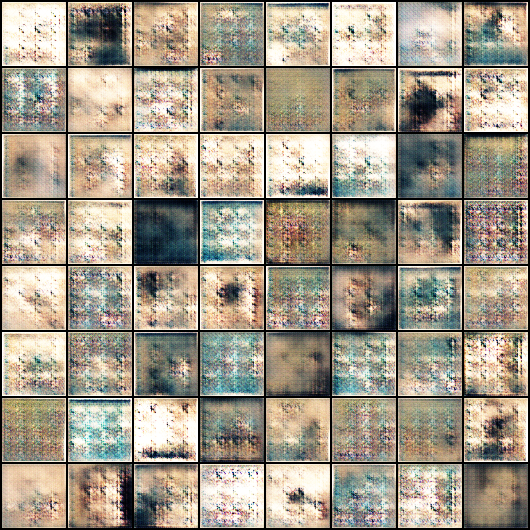

In [40]:
I('./generated/generated-images-0010.png')

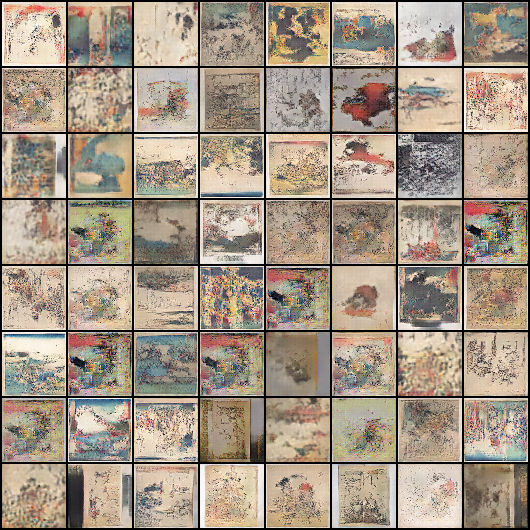

In [41]:
I('./generated/generated-images-0141.png')

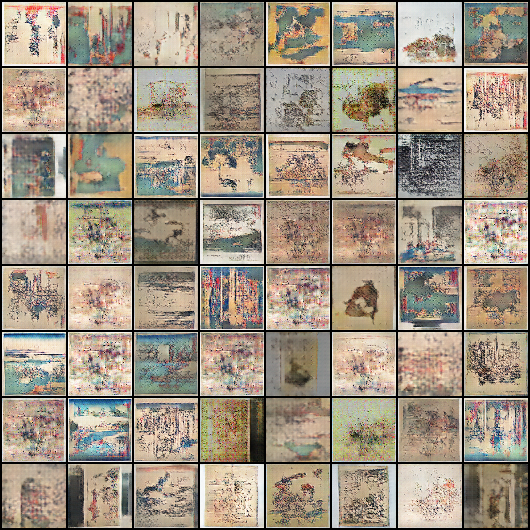

In [42]:
I('./generated/generated-images-0150.png')

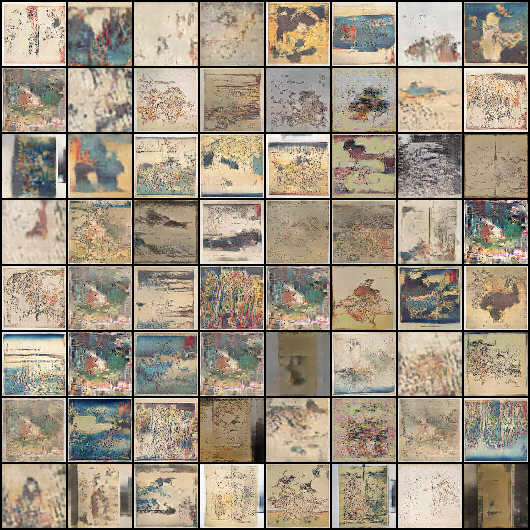

In [43]:
I('./generated/generated-images-0200.png')

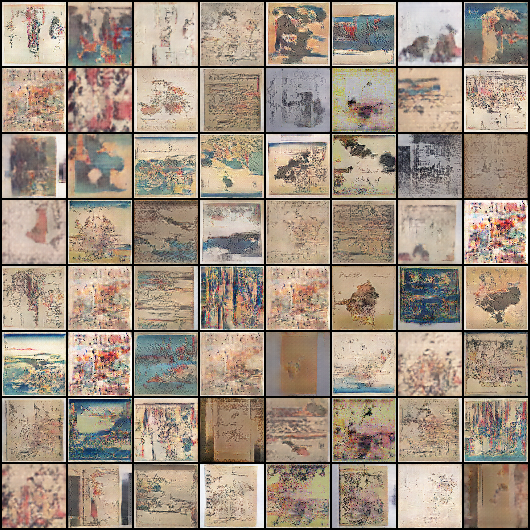

In [44]:
I('./generated/generated-images-0250.png')

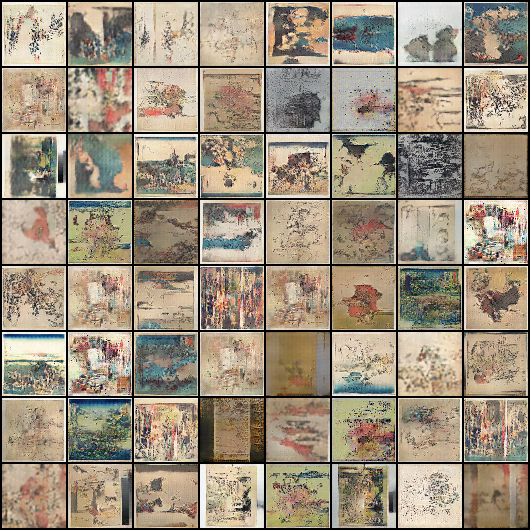

In [45]:
I('./generated/generated-images-0300.png')

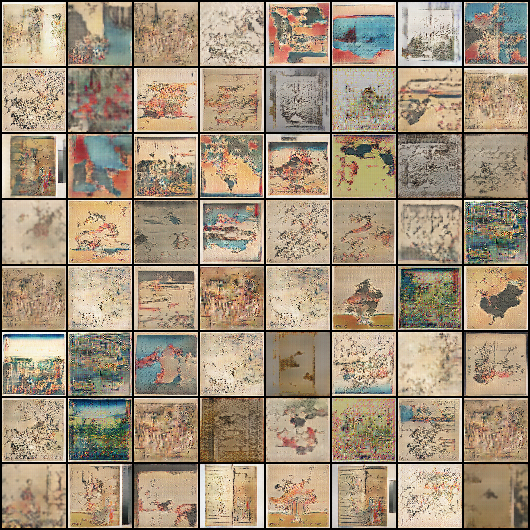

In [46]:
I('./generated/generated-images-0450.png')

# Final Results
Plot graphs with loss and accuracy and elaborate a video with the images generated during the training progress

In [47]:
losses_g, losses_d, real_scores, fake_scores = history

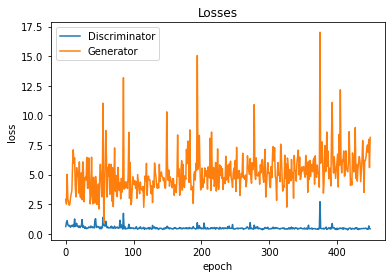

In [48]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

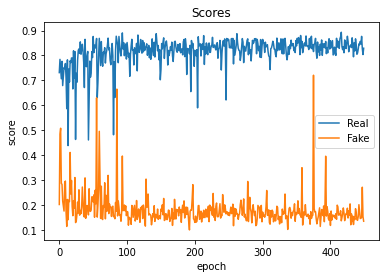

In [49]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

In [50]:
import cv2
import os

# Generating a video with some of the images generated during training

vid_fname = 'gans_training.avi'

files = [os.path.join(sample_dir, f) for f in os.listdir(sample_dir) if 'generated' in f]
files.sort()

fourcc = cv2.VideoWriter_fourcc(*'XVID')

out = cv2.VideoWriter(vid_fname,cv2.VideoWriter_fourcc(*'DIVX'), 10, (530,530))
 
[out.write(cv2.imread(fname)) for fname in files]
out.release()


# Conditional GAN (cGAN)
In the second part of the project we will try to model a cGAN according to [this paper](https://arxiv.org/abs/1411.1784) in order to generate Ukiyo-e in the style of the selected author from the dataset

## Parameters
This cGAN works best with 128x128 images, so we reload them

In [51]:
batch_size = 128
image_size = (128,128)
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
beta1 = 0.5

image_shape = (3, 128, 128)
image_dim = int(np.prod(image_shape))

n_classes = 50
embedding_dim = 100

In [52]:
data_path = "data_cgan.npy"

In [53]:
if not os.path.exists(data_path):
    # RELOAD all data 
    dataset   = []
    labels    = []
    print("Loading dataset...")
    for file in tqdm(names):
        path=os.path.join(train_dir,file)
        for im in os.listdir(path):
            image=load_img(os.path.join(path,im), grayscale=False, color_mode='rgb',target_size=image_size)
            image=img_to_array(image, dtype='uint8')
            
            ## AHUGmentation!
            dataset.append(image)
            image_base = Image.fromarray(image.astype(np.uint8))
            
            image = transforms.RandomVerticalFlip(p=1)(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            image = transforms.ColorJitter(brightness=.2, hue=.0)(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            image = transforms.RandomResizedCrop(size=(128, 128))(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            image = transforms.RandomPosterize(bits=2)(image_base)
            image=img_to_array(image, dtype='uint8')
            dataset.append(image)
            
            for j in range(5):
                labels.append(classes_dict[file])
           
    with open(data_path, 'wb') as f:
        np.save(f, np.asarray(dataset))
        np.save(f, np.asarray(labels))
else:
    with open(data_path, 'rb') as f:
        dataset = list(np.load(f,allow_pickle=True))
        labels  = list(np.load(f,allow_pickle=True))


Loading dataset...


  0%|          | 0/50 [00:00<?, ?it/s]

In [54]:
dataset = np.asarray(dataset)
transform_ds = transforms.Compose([
                                   transforms.Resize(image_size),
                                   transforms.CenterCrop(image_size),
                                   transforms.ToTensor(),
                                   transforms.Normalize(*stats)
                                   ])

ds_3 = MyDataset(dataset,labels,transform=transform_ds)
print("Dataset elements number:",len(ds_3))

train_dl_2 = DataLoader(ds_3, batch_size, shuffle=True, num_workers=2, pin_memory=True)

Dataset elements number: 20090


In [55]:
# custom weights initialization called on generator and discriminator
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        torch.nn.init.normal_(m.weight, 1.0, 0.02)
        torch.nn.init.zeros_(m.bias)

# cGAN Model
![img](https://learnopencv.com/wp-content/uploads/2020/12/conditional-gan-tech-arch-516x1024.jpg)

*Shape of the models*

## Discriminator

In [56]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
    
        self.label_condition_disc = nn.Sequential(nn.Embedding(n_classes, embedding_dim),
                      nn.Linear(embedding_dim, 3*128*128))
             
        self.model = nn.Sequential(nn.Conv2d(6, 64, 4, 2, 1, bias=False),
                      nn.LeakyReLU(0.2, inplace=True),
                      nn.Conv2d(64, 64*2, 4, 3, 2, bias=False),
                      nn.BatchNorm2d(64*2, momentum=0.1,  eps=0.8),
                      nn.LeakyReLU(0.2, inplace=True),
                      nn.Conv2d(64*2, 64*4, 4, 3,2, bias=False),
                      nn.BatchNorm2d(64*4, momentum=0.1,  eps=0.8),
                      nn.LeakyReLU(0.2, inplace=True),
                      nn.Conv2d(64*4, 64*8, 4, 3, 2, bias=False),
                      nn.BatchNorm2d(64*8, momentum=0.1,  eps=0.8),
                      nn.LeakyReLU(0.2, inplace=True), 
                      nn.Flatten(),
                      nn.Dropout(0.4),
                      nn.Linear(4608, 1),
                      nn.Sigmoid()
                     )

    def forward(self, inputs):
        img, label = inputs
        label_output = self.label_condition_disc(label)
        label_output = label_output.view(-1, 3, 128, 128)
        concat = torch.cat((img, label_output), dim=1)
        #print(concat.size())
        output = self.model(concat)
        return output

In [57]:
discriminator = Discriminator().to(device)
discriminator.apply(weights_init)
print(discriminator)
summary(discriminator.model,(6,128,128))

Discriminator(
  (label_condition_disc): Sequential(
    (0): Embedding(50, 100)
    (1): Linear(in_features=100, out_features=49152, bias=True)
  )
  (model): Sequential(
    (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(3, 3), padding=(2, 2), bias=False)
    (3): BatchNorm2d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(3, 3), padding=(2, 2), bias=False)
    (6): BatchNorm2d(256, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(3, 3), padding=(2, 2), bias=False)
    (9): BatchNorm2d(512, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)

## Generator

In [58]:
latent_dim = 100

In [59]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
     
        self.label_conditioned_generator = nn.Sequential(nn.Embedding(n_classes, embedding_dim),
                      nn.Linear(embedding_dim, 16))
        
    
        self.latent = nn.Sequential(nn.Linear(latent_dim, 4*4*512),
                                   nn.LeakyReLU(0.2, inplace=True))
           

        self.model = nn.Sequential(nn.ConvTranspose2d(513, 64*8, 4, 2, 1, bias=False),
                      nn.BatchNorm2d(64*8, momentum=0.1,  eps=0.8),
                      nn.ReLU(True),
                      nn.ConvTranspose2d(64*8, 64*4, 4, 2, 1,bias=False),
                      nn.BatchNorm2d(64*4, momentum=0.1,  eps=0.8),
                      nn.ReLU(True), 
                      nn.ConvTranspose2d(64*4, 64*2, 4, 2, 1,bias=False),
                      nn.BatchNorm2d(64*2, momentum=0.1,  eps=0.8),
                      nn.ReLU(True), 
                      nn.ConvTranspose2d(64*2, 64*1, 4, 2, 1,bias=False),
                      nn.BatchNorm2d(64*1, momentum=0.1,  eps=0.8),
                      nn.ReLU(True), 
                      nn.ConvTranspose2d(64*1, 3, 4, 2, 1, bias=False),
                      nn.Tanh())

    def forward(self, inputs):
        noise_vector, label = inputs
        label_output = self.label_conditioned_generator(label)
        label_output = label_output.view(-1, 1, 4, 4)
        latent_output = self.latent(noise_vector)
        latent_output = latent_output.view(-1, 512,4,4)
        concat = torch.cat((latent_output, label_output), dim=1)
        image = self.model(concat)
        #print(image.size())
        return image

In [60]:
generator = Generator().to(device)
generator.apply(weights_init)
print(generator)
summary(generator.model,(513,4,4))

Generator(
  (label_conditioned_generator): Sequential(
    (0): Embedding(50, 100)
    (1): Linear(in_features=100, out_features=16, bias=True)
  )
  (latent): Sequential(
    (0): Linear(in_features=100, out_features=8192, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (model): Sequential(
    (0): ConvTranspose2d(513, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_s

# Training cGAN

In [61]:
import torch.optim as optim
import torchvision.utils as vutils
import torchvision.datasets as dset

from torchvision.utils import save_image

from torchvision import datasets, transforms
from torch.autograd import Variable
from torchvision.utils import save_image
from torchvision.utils import make_grid
from torch.utils.tensorboard import SummaryWriter

In [62]:
adversarial_loss = nn.BCELoss()

In [63]:
def generator_loss(fake_output, label):
    gen_loss = adversarial_loss(fake_output, label)
    #print(gen_loss)
    return gen_loss

def discriminator_loss(output, label):
    disc_loss = adversarial_loss(output, label)
    return disc_loss

In [64]:
learning_rate = 0.0002 
G_optimizer = optim.Adam(generator.parameters(), lr = learning_rate, betas=(0.5, 0.999))
D_optimizer = optim.Adam(discriminator.parameters(), lr = learning_rate, betas=(0.5, 0.999))

In [65]:
num_epochs = 450
D_loss_plot, G_loss_plot = [], []
for epoch in range(1, num_epochs+1): 

    D_loss_list, G_loss_list = [], []
   
    for index, (real_images, labels) in enumerate(tqdm(train_dl_2)):
                
        D_optimizer.zero_grad()
        real_images = real_images.to(device)
        labels = labels.to(device)
        labels = labels.unsqueeze(1).long()

      
        real_target = Variable(torch.ones(real_images.size(0), 1).to(device))
        fake_target = Variable(torch.zeros(real_images.size(0), 1).to(device))
      
        D_real_loss = discriminator_loss(discriminator((real_images, labels)), real_target)
        #print(discriminator(real_images))
        #D_real_loss.backward()
    
        noise_vector = torch.randn(real_images.size(0), latent_dim, device=device)  
        noise_vector = noise_vector.to(device)
        
       
        generated_image = generator((noise_vector, labels))
        #save_samples(index,noise_vector,show=False)
        output = discriminator((generated_image.detach(), labels))
        D_fake_loss = discriminator_loss(output,  fake_target)

    
        # train with fake
        #D_fake_loss.backward()
      
        D_total_loss = (D_real_loss + D_fake_loss) / 2
        D_loss_list.append(D_total_loss)
      
        D_total_loss.backward()
        D_optimizer.step()

        # Train generator with real labels
        G_optimizer.zero_grad()
        G_loss = generator_loss(discriminator((generated_image, labels)), real_target)
        G_loss_list.append(G_loss)

        G_loss.backward()
        G_optimizer.step()


    print('Epoch: [%d/%d]: D_loss: %.3f, G_loss: %.3f' % (
            (epoch), num_epochs, torch.mean(torch.FloatTensor(D_loss_list)),\
             torch.mean(torch.FloatTensor(G_loss_list))))
    
    D_loss_plot.append(torch.mean(torch.FloatTensor(D_loss_list)))
    G_loss_plot.append(torch.mean(torch.FloatTensor(G_loss_list)))
    save_image(generated_image.data[:50], 'generated/sample_%d'%epoch + '.png', nrow=5, normalize=True)

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [1/450]: D_loss: 0.469, G_loss: 1.564


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [2/450]: D_loss: 0.446, G_loss: 2.091


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [3/450]: D_loss: 0.504, G_loss: 2.262


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [4/450]: D_loss: 0.563, G_loss: 1.656


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [5/450]: D_loss: 0.506, G_loss: 1.763


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [6/450]: D_loss: 0.467, G_loss: 1.868


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [7/450]: D_loss: 0.446, G_loss: 2.080


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [8/450]: D_loss: 0.433, G_loss: 2.252


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [9/450]: D_loss: 0.353, G_loss: 2.591


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [10/450]: D_loss: 0.352, G_loss: 2.584


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [11/450]: D_loss: 0.347, G_loss: 2.680


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [12/450]: D_loss: 0.307, G_loss: 2.890


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [13/450]: D_loss: 0.344, G_loss: 3.010


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [14/450]: D_loss: 0.389, G_loss: 2.783


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [15/450]: D_loss: 0.375, G_loss: 2.684


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [16/450]: D_loss: 0.334, G_loss: 2.837


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [17/450]: D_loss: 0.397, G_loss: 2.692


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [18/450]: D_loss: 0.406, G_loss: 2.632


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [19/450]: D_loss: 0.372, G_loss: 2.666


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [20/450]: D_loss: 0.394, G_loss: 2.898


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [21/450]: D_loss: 0.403, G_loss: 2.732


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [22/450]: D_loss: 0.408, G_loss: 2.768


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [23/450]: D_loss: 0.412, G_loss: 2.616


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [24/450]: D_loss: 0.417, G_loss: 2.808


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [25/450]: D_loss: 0.369, G_loss: 2.880


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [26/450]: D_loss: 0.382, G_loss: 2.876


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [27/450]: D_loss: 0.383, G_loss: 2.816


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [28/450]: D_loss: 0.375, G_loss: 3.162


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [29/450]: D_loss: 0.384, G_loss: 2.935


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [30/450]: D_loss: 0.407, G_loss: 3.087


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [31/450]: D_loss: 0.370, G_loss: 3.113


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [32/450]: D_loss: 0.324, G_loss: 3.307


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [33/450]: D_loss: 0.377, G_loss: 3.122


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [34/450]: D_loss: 0.351, G_loss: 3.238


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [35/450]: D_loss: 0.380, G_loss: 3.113


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [36/450]: D_loss: 0.360, G_loss: 3.155


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [37/450]: D_loss: 0.343, G_loss: 3.271


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [38/450]: D_loss: 0.367, G_loss: 3.279


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [39/450]: D_loss: 0.312, G_loss: 3.134


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [40/450]: D_loss: 0.348, G_loss: 3.483


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [41/450]: D_loss: 0.326, G_loss: 3.736


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [42/450]: D_loss: 0.322, G_loss: 3.350


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [43/450]: D_loss: 0.276, G_loss: 3.593


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [44/450]: D_loss: 0.334, G_loss: 3.711


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [45/450]: D_loss: 0.322, G_loss: 3.492


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [46/450]: D_loss: 0.314, G_loss: 3.755


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [47/450]: D_loss: 0.305, G_loss: 3.350


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [48/450]: D_loss: 0.310, G_loss: 3.618


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [49/450]: D_loss: 0.313, G_loss: 3.756


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [50/450]: D_loss: 0.337, G_loss: 3.680


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [51/450]: D_loss: 0.295, G_loss: 3.714


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [52/450]: D_loss: 0.291, G_loss: 3.704


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [53/450]: D_loss: 0.305, G_loss: 3.901


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [54/450]: D_loss: 0.304, G_loss: 3.880


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [55/450]: D_loss: 0.291, G_loss: 3.673


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [56/450]: D_loss: 0.259, G_loss: 3.702


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [57/450]: D_loss: 0.280, G_loss: 3.989


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [58/450]: D_loss: 0.305, G_loss: 4.019


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [59/450]: D_loss: 0.284, G_loss: 3.958


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [60/450]: D_loss: 0.265, G_loss: 4.072


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [61/450]: D_loss: 0.245, G_loss: 4.086


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [62/450]: D_loss: 0.269, G_loss: 4.135


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [63/450]: D_loss: 0.287, G_loss: 3.929


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [64/450]: D_loss: 0.270, G_loss: 4.324


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [65/450]: D_loss: 0.265, G_loss: 3.941


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [66/450]: D_loss: 0.275, G_loss: 4.044


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [67/450]: D_loss: 0.274, G_loss: 4.013


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [68/450]: D_loss: 0.243, G_loss: 4.252


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [69/450]: D_loss: 0.258, G_loss: 4.262


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [70/450]: D_loss: 0.248, G_loss: 4.275


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [71/450]: D_loss: 0.254, G_loss: 4.477


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [72/450]: D_loss: 0.273, G_loss: 4.309


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [73/450]: D_loss: 0.218, G_loss: 4.258


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [74/450]: D_loss: 0.251, G_loss: 4.376


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [75/450]: D_loss: 0.280, G_loss: 4.223


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [76/450]: D_loss: 0.252, G_loss: 4.274


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [77/450]: D_loss: 0.271, G_loss: 4.552


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [78/450]: D_loss: 0.257, G_loss: 4.406


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [79/450]: D_loss: 0.255, G_loss: 4.197


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [80/450]: D_loss: 0.262, G_loss: 4.175


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [81/450]: D_loss: 0.235, G_loss: 4.353


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [82/450]: D_loss: 0.232, G_loss: 4.368


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [83/450]: D_loss: 0.228, G_loss: 4.472


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [84/450]: D_loss: 0.234, G_loss: 4.590


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [85/450]: D_loss: 0.257, G_loss: 4.531


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [86/450]: D_loss: 0.216, G_loss: 4.475


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [87/450]: D_loss: 0.233, G_loss: 4.382


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [88/450]: D_loss: 0.243, G_loss: 4.402


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [89/450]: D_loss: 0.265, G_loss: 4.452


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [90/450]: D_loss: 0.252, G_loss: 4.512


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [91/450]: D_loss: 0.255, G_loss: 4.304


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [92/450]: D_loss: 0.260, G_loss: 4.398


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [93/450]: D_loss: 0.211, G_loss: 4.354


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [94/450]: D_loss: 0.252, G_loss: 4.606


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [95/450]: D_loss: 0.217, G_loss: 4.406


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [96/450]: D_loss: 0.211, G_loss: 4.565


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [97/450]: D_loss: 0.245, G_loss: 4.716


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [98/450]: D_loss: 0.216, G_loss: 4.533


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [99/450]: D_loss: 0.217, G_loss: 4.675


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [100/450]: D_loss: 0.200, G_loss: 4.597


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [101/450]: D_loss: 0.202, G_loss: 4.673


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [102/450]: D_loss: 0.181, G_loss: 4.683


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [103/450]: D_loss: 0.248, G_loss: 5.188


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [104/450]: D_loss: 0.202, G_loss: 4.881


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [105/450]: D_loss: 0.232, G_loss: 5.282


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [106/450]: D_loss: 0.202, G_loss: 4.554


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [107/450]: D_loss: 0.206, G_loss: 4.799


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [108/450]: D_loss: 0.194, G_loss: 4.678


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [109/450]: D_loss: 0.205, G_loss: 4.989


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [110/450]: D_loss: 0.221, G_loss: 5.237


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [111/450]: D_loss: 0.188, G_loss: 4.751


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [112/450]: D_loss: 0.206, G_loss: 4.922


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [113/450]: D_loss: 0.199, G_loss: 5.016


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [114/450]: D_loss: 0.205, G_loss: 4.845


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [115/450]: D_loss: 0.175, G_loss: 4.822


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [116/450]: D_loss: 0.219, G_loss: 5.098


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [117/450]: D_loss: 0.196, G_loss: 4.850


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [118/450]: D_loss: 0.226, G_loss: 4.945


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [119/450]: D_loss: 0.168, G_loss: 4.932


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [120/450]: D_loss: 0.203, G_loss: 4.894


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [121/450]: D_loss: 0.198, G_loss: 5.020


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [122/450]: D_loss: 0.194, G_loss: 4.755


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [123/450]: D_loss: 0.204, G_loss: 5.129


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [124/450]: D_loss: 0.175, G_loss: 5.218


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [125/450]: D_loss: 0.183, G_loss: 5.075


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [126/450]: D_loss: 0.204, G_loss: 5.333


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [127/450]: D_loss: 0.191, G_loss: 4.888


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [128/450]: D_loss: 0.218, G_loss: 5.362


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [129/450]: D_loss: 0.202, G_loss: 4.921


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [130/450]: D_loss: 0.183, G_loss: 5.115


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [131/450]: D_loss: 0.156, G_loss: 4.988


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [132/450]: D_loss: 0.170, G_loss: 5.095


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [133/450]: D_loss: 0.136, G_loss: 5.201


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [134/450]: D_loss: 0.160, G_loss: 5.489


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [135/450]: D_loss: 0.139, G_loss: 5.411


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [136/450]: D_loss: 0.170, G_loss: 5.770


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [137/450]: D_loss: 0.171, G_loss: 5.877


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [138/450]: D_loss: 0.146, G_loss: 5.515


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [139/450]: D_loss: 0.179, G_loss: 5.950


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [140/450]: D_loss: 0.160, G_loss: 5.982


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [141/450]: D_loss: 0.141, G_loss: 5.881


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [142/450]: D_loss: 0.147, G_loss: 6.329


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [143/450]: D_loss: 0.145, G_loss: 5.967


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [144/450]: D_loss: 0.158, G_loss: 5.476


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [145/450]: D_loss: 0.121, G_loss: 5.637


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [146/450]: D_loss: 0.142, G_loss: 5.964


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [147/450]: D_loss: 0.126, G_loss: 5.868


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [148/450]: D_loss: 0.159, G_loss: 6.408


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [149/450]: D_loss: 0.164, G_loss: 6.394


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [150/450]: D_loss: 0.127, G_loss: 5.873


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [151/450]: D_loss: 0.160, G_loss: 6.474


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [152/450]: D_loss: 0.138, G_loss: 5.910


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [153/450]: D_loss: 0.122, G_loss: 5.581


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [154/450]: D_loss: 0.133, G_loss: 6.440


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [155/450]: D_loss: 0.139, G_loss: 6.116


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [156/450]: D_loss: 0.139, G_loss: 6.175


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [157/450]: D_loss: 0.114, G_loss: 6.269


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [158/450]: D_loss: 0.118, G_loss: 6.079


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [159/450]: D_loss: 0.136, G_loss: 6.325


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [160/450]: D_loss: 0.120, G_loss: 6.368


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [161/450]: D_loss: 0.170, G_loss: 6.687


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [162/450]: D_loss: 0.134, G_loss: 6.090


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [163/450]: D_loss: 0.127, G_loss: 6.028


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [164/450]: D_loss: 0.146, G_loss: 6.735


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [165/450]: D_loss: 0.112, G_loss: 6.384


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [166/450]: D_loss: 0.110, G_loss: 6.334


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [167/450]: D_loss: 0.132, G_loss: 6.694


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [168/450]: D_loss: 0.115, G_loss: 6.540


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [169/450]: D_loss: 0.108, G_loss: 6.517


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [170/450]: D_loss: 0.090, G_loss: 6.227


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [171/450]: D_loss: 0.132, G_loss: 6.536


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [172/450]: D_loss: 0.119, G_loss: 6.750


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [173/450]: D_loss: 0.152, G_loss: 6.950


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [174/450]: D_loss: 0.080, G_loss: 6.159


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [175/450]: D_loss: 0.125, G_loss: 6.920


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [176/450]: D_loss: 0.106, G_loss: 6.507


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [177/450]: D_loss: 0.111, G_loss: 6.342


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [178/450]: D_loss: 0.201, G_loss: 6.676


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [179/450]: D_loss: 0.122, G_loss: 6.220


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [180/450]: D_loss: 0.115, G_loss: 6.658


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [181/450]: D_loss: 0.103, G_loss: 6.265


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [182/450]: D_loss: 0.122, G_loss: 6.691


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [183/450]: D_loss: 0.136, G_loss: 6.898


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [184/450]: D_loss: 0.112, G_loss: 6.706


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [185/450]: D_loss: 0.146, G_loss: 6.595


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [186/450]: D_loss: 0.104, G_loss: 6.402


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [187/450]: D_loss: 0.119, G_loss: 6.491


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [188/450]: D_loss: 0.129, G_loss: 6.666


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [189/450]: D_loss: 0.090, G_loss: 6.132


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [190/450]: D_loss: 0.145, G_loss: 6.290


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [191/450]: D_loss: 0.137, G_loss: 6.608


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [192/450]: D_loss: 0.095, G_loss: 6.010


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [193/450]: D_loss: 0.132, G_loss: 6.348


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [194/450]: D_loss: 0.132, G_loss: 6.537


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [195/450]: D_loss: 0.083, G_loss: 6.147


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [196/450]: D_loss: 0.138, G_loss: 6.574


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [197/450]: D_loss: 0.099, G_loss: 6.578


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [198/450]: D_loss: 0.123, G_loss: 6.838


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [199/450]: D_loss: 0.107, G_loss: 6.608


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [200/450]: D_loss: 0.127, G_loss: 6.757


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [201/450]: D_loss: 0.118, G_loss: 6.802


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [202/450]: D_loss: 0.114, G_loss: 6.641


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [203/450]: D_loss: 0.125, G_loss: 6.821


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [204/450]: D_loss: 0.116, G_loss: 6.401


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [205/450]: D_loss: 0.113, G_loss: 6.667


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [206/450]: D_loss: 0.143, G_loss: 6.888


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [207/450]: D_loss: 0.082, G_loss: 6.674


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [208/450]: D_loss: 0.101, G_loss: 6.926


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [209/450]: D_loss: 0.088, G_loss: 6.748


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [210/450]: D_loss: 0.084, G_loss: 6.866


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [211/450]: D_loss: 0.117, G_loss: 7.235


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [212/450]: D_loss: 0.106, G_loss: 6.790


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [213/450]: D_loss: 0.093, G_loss: 6.969


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [214/450]: D_loss: 0.141, G_loss: 7.525


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [215/450]: D_loss: 0.103, G_loss: 7.167


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [216/450]: D_loss: 0.109, G_loss: 7.515


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [217/450]: D_loss: 0.081, G_loss: 6.857


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [218/450]: D_loss: 0.109, G_loss: 6.960


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [219/450]: D_loss: 0.116, G_loss: 7.069


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [220/450]: D_loss: 0.064, G_loss: 6.470


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [221/450]: D_loss: 0.119, G_loss: 7.069


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [222/450]: D_loss: 0.102, G_loss: 6.712


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [223/450]: D_loss: 0.103, G_loss: 6.697


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [224/450]: D_loss: 0.091, G_loss: 7.171


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [225/450]: D_loss: 0.081, G_loss: 6.560


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [226/450]: D_loss: 0.067, G_loss: 6.960


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [227/450]: D_loss: 0.127, G_loss: 7.498


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [228/450]: D_loss: 0.118, G_loss: 7.083


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [229/450]: D_loss: 0.129, G_loss: 6.808


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [230/450]: D_loss: 0.090, G_loss: 7.047


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [231/450]: D_loss: 0.111, G_loss: 6.731


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [232/450]: D_loss: 0.111, G_loss: 6.590


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [233/450]: D_loss: 0.103, G_loss: 6.579


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [234/450]: D_loss: 0.085, G_loss: 6.637


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [235/450]: D_loss: 0.079, G_loss: 6.814


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [236/450]: D_loss: 0.074, G_loss: 7.182


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [237/450]: D_loss: 0.070, G_loss: 7.286


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [238/450]: D_loss: 0.091, G_loss: 7.745


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [239/450]: D_loss: 0.106, G_loss: 7.472


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [240/450]: D_loss: 0.103, G_loss: 7.111


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [241/450]: D_loss: 0.064, G_loss: 7.010


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [242/450]: D_loss: 0.072, G_loss: 7.342


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [243/450]: D_loss: 0.095, G_loss: 7.290


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [244/450]: D_loss: 0.105, G_loss: 7.283


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [245/450]: D_loss: 0.086, G_loss: 7.649


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [246/450]: D_loss: 0.107, G_loss: 7.061


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [247/450]: D_loss: 0.087, G_loss: 7.064


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [248/450]: D_loss: 0.082, G_loss: 7.283


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [249/450]: D_loss: 0.106, G_loss: 7.505


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [250/450]: D_loss: 0.088, G_loss: 7.422


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [251/450]: D_loss: 0.067, G_loss: 6.803


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [252/450]: D_loss: 0.089, G_loss: 7.233


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [253/450]: D_loss: 0.073, G_loss: 7.089


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [254/450]: D_loss: 0.094, G_loss: 7.482


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [255/450]: D_loss: 0.086, G_loss: 7.360


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [256/450]: D_loss: 0.080, G_loss: 6.997


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [257/450]: D_loss: 0.054, G_loss: 6.753


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [258/450]: D_loss: 0.082, G_loss: 7.499


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [259/450]: D_loss: 0.092, G_loss: 7.740


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [260/450]: D_loss: 0.087, G_loss: 7.675


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [261/450]: D_loss: 0.087, G_loss: 7.363


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [262/450]: D_loss: 0.096, G_loss: 7.208


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [263/450]: D_loss: 0.084, G_loss: 6.920


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [264/450]: D_loss: 0.138, G_loss: 7.590


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [265/450]: D_loss: 0.095, G_loss: 7.158


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [266/450]: D_loss: 0.081, G_loss: 7.428


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [267/450]: D_loss: 0.070, G_loss: 7.098


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [268/450]: D_loss: 0.075, G_loss: 7.434


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [269/450]: D_loss: 0.069, G_loss: 7.425


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [270/450]: D_loss: 0.093, G_loss: 8.200


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [271/450]: D_loss: 0.073, G_loss: 7.261


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [272/450]: D_loss: 0.061, G_loss: 6.921


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [273/450]: D_loss: 0.074, G_loss: 7.391


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [274/450]: D_loss: 0.078, G_loss: 7.830


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [275/450]: D_loss: 0.097, G_loss: 7.974


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [276/450]: D_loss: 0.063, G_loss: 7.109


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [277/450]: D_loss: 0.077, G_loss: 7.709


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [278/450]: D_loss: 0.070, G_loss: 7.409


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [279/450]: D_loss: 0.089, G_loss: 7.436


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [280/450]: D_loss: 0.108, G_loss: 7.233


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [281/450]: D_loss: 0.086, G_loss: 7.511


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [282/450]: D_loss: 0.111, G_loss: 7.127


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [283/450]: D_loss: 0.088, G_loss: 7.329


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [284/450]: D_loss: 0.048, G_loss: 7.064


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [285/450]: D_loss: 0.069, G_loss: 6.917


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [286/450]: D_loss: 0.083, G_loss: 7.422


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [287/450]: D_loss: 0.100, G_loss: 7.871


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [288/450]: D_loss: 0.092, G_loss: 7.344


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [289/450]: D_loss: 0.056, G_loss: 7.148


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [290/450]: D_loss: 0.085, G_loss: 8.383


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [291/450]: D_loss: 0.075, G_loss: 7.439


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [292/450]: D_loss: 0.063, G_loss: 7.418


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [293/450]: D_loss: 0.062, G_loss: 7.741


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [294/450]: D_loss: 0.127, G_loss: 8.304


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [295/450]: D_loss: 0.072, G_loss: 7.787


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [296/450]: D_loss: 0.059, G_loss: 7.278


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [297/450]: D_loss: 0.083, G_loss: 7.912


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [298/450]: D_loss: 0.065, G_loss: 7.764


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [299/450]: D_loss: 0.086, G_loss: 8.349


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [300/450]: D_loss: 0.109, G_loss: 8.622


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [301/450]: D_loss: 0.063, G_loss: 7.000


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [302/450]: D_loss: 0.077, G_loss: 7.189


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [303/450]: D_loss: 0.059, G_loss: 6.980


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [304/450]: D_loss: 0.061, G_loss: 7.746


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [305/450]: D_loss: 0.085, G_loss: 8.318


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [306/450]: D_loss: 0.058, G_loss: 7.451


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [307/450]: D_loss: 0.084, G_loss: 7.562


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [308/450]: D_loss: 0.087, G_loss: 8.063


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [309/450]: D_loss: 0.054, G_loss: 7.708


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [310/450]: D_loss: 0.067, G_loss: 8.208


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [311/450]: D_loss: 0.070, G_loss: 8.355


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [312/450]: D_loss: 0.092, G_loss: 7.618


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [313/450]: D_loss: 0.056, G_loss: 7.228


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [314/450]: D_loss: 0.075, G_loss: 7.929


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [315/450]: D_loss: 0.104, G_loss: 7.703


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [316/450]: D_loss: 0.074, G_loss: 7.775


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [317/450]: D_loss: 0.068, G_loss: 7.314


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [318/450]: D_loss: 0.075, G_loss: 7.310


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [319/450]: D_loss: 0.074, G_loss: 7.517


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [320/450]: D_loss: 0.090, G_loss: 7.893


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [321/450]: D_loss: 0.089, G_loss: 7.858


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [322/450]: D_loss: 0.055, G_loss: 7.251


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [323/450]: D_loss: 0.079, G_loss: 8.118


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [324/450]: D_loss: 0.090, G_loss: 8.025


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [325/450]: D_loss: 0.077, G_loss: 7.459


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [326/450]: D_loss: 0.081, G_loss: 8.189


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [327/450]: D_loss: 0.059, G_loss: 6.938


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [328/450]: D_loss: 0.067, G_loss: 7.519


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [329/450]: D_loss: 0.060, G_loss: 7.517


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [330/450]: D_loss: 0.042, G_loss: 7.460


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [331/450]: D_loss: 0.100, G_loss: 8.724


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [332/450]: D_loss: 0.061, G_loss: 8.312


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [333/450]: D_loss: 0.081, G_loss: 8.304


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [334/450]: D_loss: 0.037, G_loss: 7.248


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [335/450]: D_loss: 0.050, G_loss: 7.280


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [336/450]: D_loss: 0.101, G_loss: 8.518


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [337/450]: D_loss: 0.050, G_loss: 7.484


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [338/450]: D_loss: 0.075, G_loss: 8.231


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [339/450]: D_loss: 0.092, G_loss: 8.481


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [340/450]: D_loss: 0.089, G_loss: 7.876


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [341/450]: D_loss: 0.064, G_loss: 7.562


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [342/450]: D_loss: 0.069, G_loss: 7.499


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [343/450]: D_loss: 0.073, G_loss: 7.040


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [344/450]: D_loss: 0.111, G_loss: 8.068


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [345/450]: D_loss: 0.068, G_loss: 8.026


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [346/450]: D_loss: 0.070, G_loss: 7.341


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [347/450]: D_loss: 0.089, G_loss: 8.131


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [348/450]: D_loss: 0.072, G_loss: 8.041


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [349/450]: D_loss: 0.061, G_loss: 7.586


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [350/450]: D_loss: 0.084, G_loss: 8.462


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [351/450]: D_loss: 0.073, G_loss: 7.263


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [352/450]: D_loss: 0.071, G_loss: 8.679


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [353/450]: D_loss: 0.071, G_loss: 7.907


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [354/450]: D_loss: 0.039, G_loss: 7.666


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [355/450]: D_loss: 0.044, G_loss: 7.744


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [356/450]: D_loss: 0.068, G_loss: 8.260


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [357/450]: D_loss: 0.058, G_loss: 8.067


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [358/450]: D_loss: 0.039, G_loss: 7.702


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [359/450]: D_loss: 0.047, G_loss: 8.418


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [360/450]: D_loss: 0.053, G_loss: 7.871


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [361/450]: D_loss: 0.040, G_loss: 7.931


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [362/450]: D_loss: 0.078, G_loss: 9.140


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [363/450]: D_loss: 0.056, G_loss: 8.206


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [364/450]: D_loss: 0.044, G_loss: 8.086


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [365/450]: D_loss: 0.049, G_loss: 7.938


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [366/450]: D_loss: 0.051, G_loss: 7.970


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [367/450]: D_loss: 0.054, G_loss: 8.571


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [368/450]: D_loss: 0.057, G_loss: 8.474


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [369/450]: D_loss: 0.092, G_loss: 8.788


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [370/450]: D_loss: 0.051, G_loss: 8.073


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [371/450]: D_loss: 0.057, G_loss: 7.877


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [372/450]: D_loss: 0.079, G_loss: 9.038


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [373/450]: D_loss: 0.057, G_loss: 7.644


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [374/450]: D_loss: 0.065, G_loss: 7.985


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [375/450]: D_loss: 0.062, G_loss: 7.640


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [376/450]: D_loss: 0.060, G_loss: 7.850


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [377/450]: D_loss: 0.098, G_loss: 8.828


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [378/450]: D_loss: 0.047, G_loss: 7.341


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [379/450]: D_loss: 0.085, G_loss: 8.467


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [380/450]: D_loss: 0.061, G_loss: 8.599


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [381/450]: D_loss: 0.044, G_loss: 8.259


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [382/450]: D_loss: 0.058, G_loss: 8.605


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [383/450]: D_loss: 0.059, G_loss: 8.543


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [384/450]: D_loss: 0.033, G_loss: 7.612


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [385/450]: D_loss: 0.056, G_loss: 8.345


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [386/450]: D_loss: 0.047, G_loss: 8.652


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [387/450]: D_loss: 0.074, G_loss: 8.322


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [388/450]: D_loss: 0.049, G_loss: 8.927


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [389/450]: D_loss: 0.058, G_loss: 8.351


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [390/450]: D_loss: 0.057, G_loss: 8.449


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [391/450]: D_loss: 0.037, G_loss: 8.437


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [392/450]: D_loss: 0.028, G_loss: 7.532


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [393/450]: D_loss: 0.058, G_loss: 8.119


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [394/450]: D_loss: 0.136, G_loss: 8.435


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [395/450]: D_loss: 0.063, G_loss: 8.214


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [396/450]: D_loss: 0.044, G_loss: 7.917


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [397/450]: D_loss: 0.040, G_loss: 8.276


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [398/450]: D_loss: 0.083, G_loss: 8.814


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [399/450]: D_loss: 0.049, G_loss: 8.183


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [400/450]: D_loss: 0.052, G_loss: 8.156


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [401/450]: D_loss: 0.035, G_loss: 8.090


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [402/450]: D_loss: 0.057, G_loss: 8.373


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [403/450]: D_loss: 0.037, G_loss: 8.303


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [404/450]: D_loss: 0.052, G_loss: 8.906


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [405/450]: D_loss: 0.019, G_loss: 7.941


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [406/450]: D_loss: 0.034, G_loss: 8.820


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [407/450]: D_loss: 0.042, G_loss: 9.163


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [408/450]: D_loss: 0.051, G_loss: 9.337


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [409/450]: D_loss: 0.026, G_loss: 8.214


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [410/450]: D_loss: 0.050, G_loss: 8.961


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [411/450]: D_loss: 0.026, G_loss: 8.484


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [412/450]: D_loss: 0.033, G_loss: 9.107


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [413/450]: D_loss: 0.048, G_loss: 8.979


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [414/450]: D_loss: 0.034, G_loss: 9.388


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [415/450]: D_loss: 0.044, G_loss: 9.415


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [416/450]: D_loss: 0.026, G_loss: 8.423


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [417/450]: D_loss: 0.057, G_loss: 10.152


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [418/450]: D_loss: 0.037, G_loss: 9.424


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [419/450]: D_loss: 0.041, G_loss: 8.522


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [420/450]: D_loss: 0.033, G_loss: 8.695


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [421/450]: D_loss: 0.040, G_loss: 8.999


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [422/450]: D_loss: 0.073, G_loss: 8.774


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [423/450]: D_loss: 0.054, G_loss: 8.676


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [424/450]: D_loss: 0.091, G_loss: 9.240


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [425/450]: D_loss: 0.052, G_loss: 8.357


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [426/450]: D_loss: 0.087, G_loss: 8.865


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [427/450]: D_loss: 0.046, G_loss: 8.852


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [428/450]: D_loss: 0.061, G_loss: 8.636


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [429/450]: D_loss: 0.053, G_loss: 8.660


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [430/450]: D_loss: 0.057, G_loss: 7.813


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [431/450]: D_loss: 0.034, G_loss: 8.134


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [432/450]: D_loss: 0.043, G_loss: 8.025


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [433/450]: D_loss: 0.053, G_loss: 9.010


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [434/450]: D_loss: 0.082, G_loss: 8.641


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [435/450]: D_loss: 0.046, G_loss: 7.673


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [436/450]: D_loss: 0.035, G_loss: 7.376


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [437/450]: D_loss: 0.027, G_loss: 7.691


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [438/450]: D_loss: 0.049, G_loss: 8.422


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [439/450]: D_loss: 0.063, G_loss: 9.325


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [440/450]: D_loss: 0.049, G_loss: 8.531


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [441/450]: D_loss: 0.059, G_loss: 9.543


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [442/450]: D_loss: 0.039, G_loss: 8.268


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [443/450]: D_loss: 0.053, G_loss: 9.131


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [444/450]: D_loss: 0.085, G_loss: 8.674


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [445/450]: D_loss: 0.054, G_loss: 8.236


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [446/450]: D_loss: 0.033, G_loss: 8.658


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [447/450]: D_loss: 0.058, G_loss: 8.530


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [448/450]: D_loss: 0.064, G_loss: 8.846


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [449/450]: D_loss: 0.093, G_loss: 9.294


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch: [450/450]: D_loss: 0.075, G_loss: 8.006


In [66]:
torch.save(generator.state_dict(), 'generator_cgan.ckpt')
torch.save(discriminator.state_dict(), 'discriminator_cgan.ckpt')

# cGAN Final Results
The final results, despite the correct training of the models, are not very impressive, mainly beacuse the dataset did not offer enough samples per author to have meaningful results in so many different artists styles

In [67]:
# Try to generate 10 image on the syle of #13 author: Hokusai
generated_image = generator((noise_vector, torch.IntTensor(np.full((122),13)).to(device)))
save_image(generated_image.data[:10], 'generated/sample_final.png', nrow=5, normalize=True)

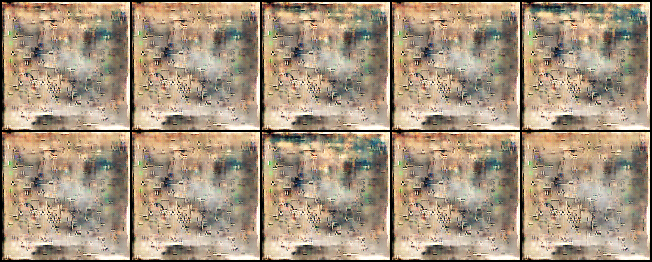

In [68]:
I('./generated/sample_final.png')

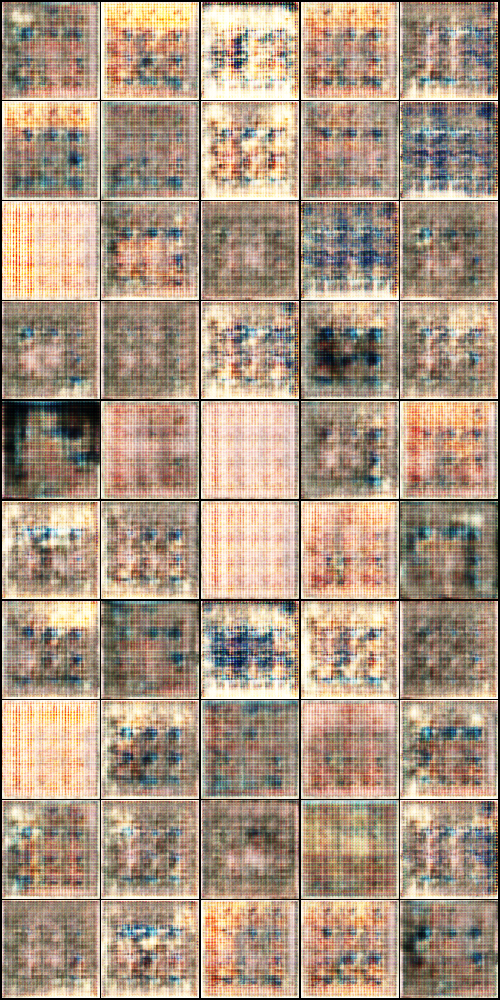

In [69]:
I('./generated/sample_10.png')

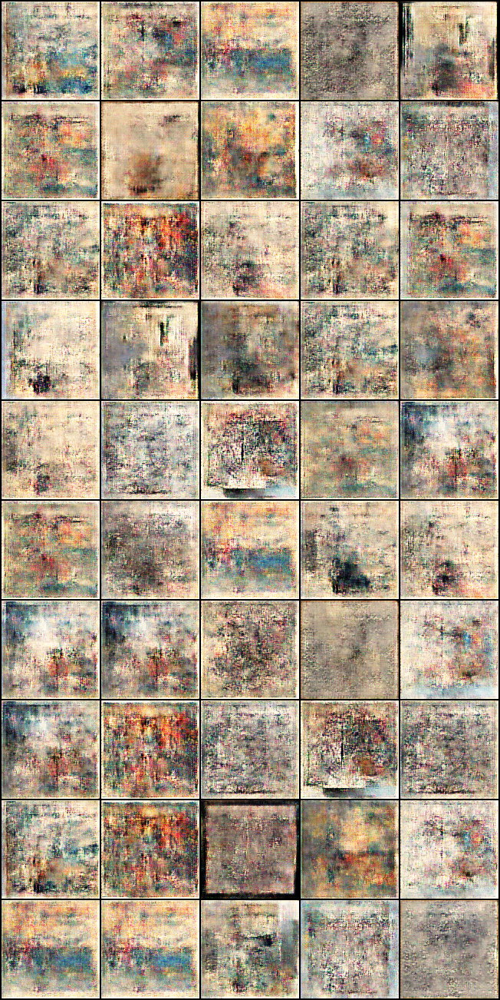

In [70]:
I('./generated/sample_100.png')

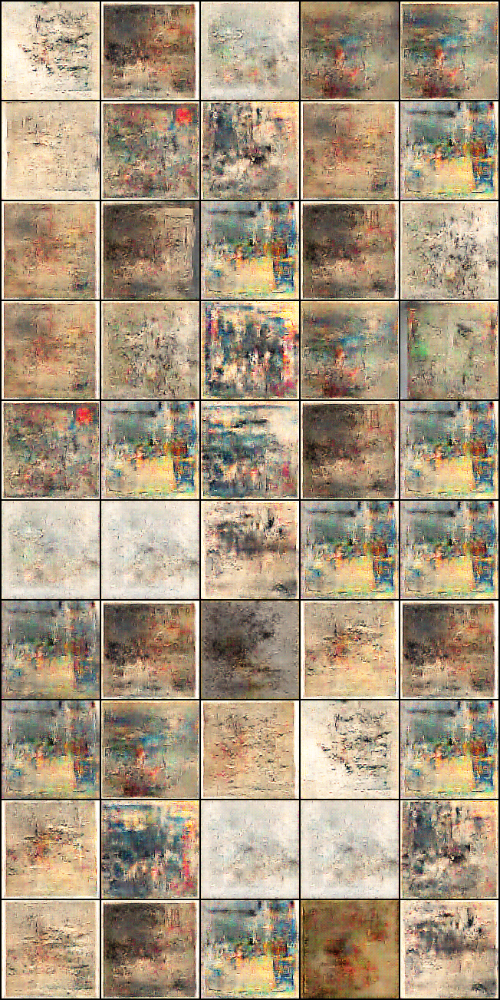

In [71]:
I('./generated/sample_200.png')

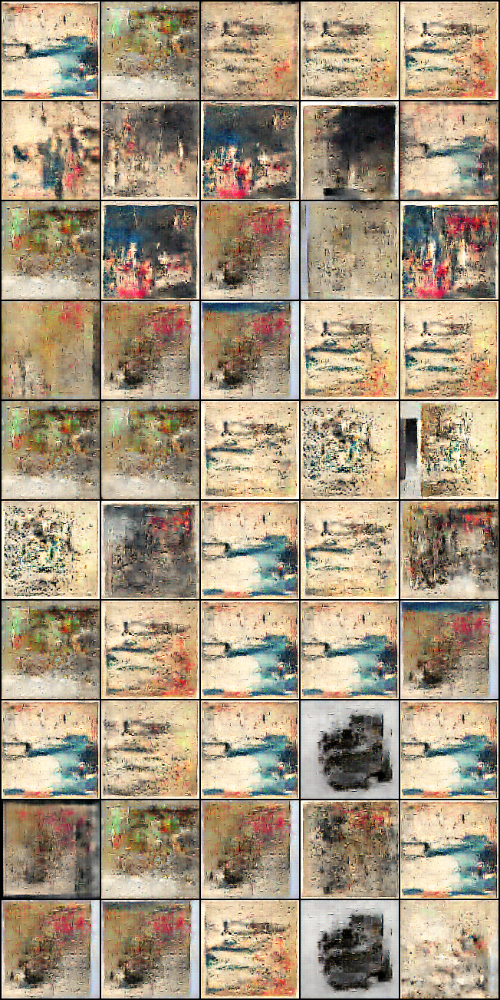

In [72]:
I('./generated/sample_300.png')

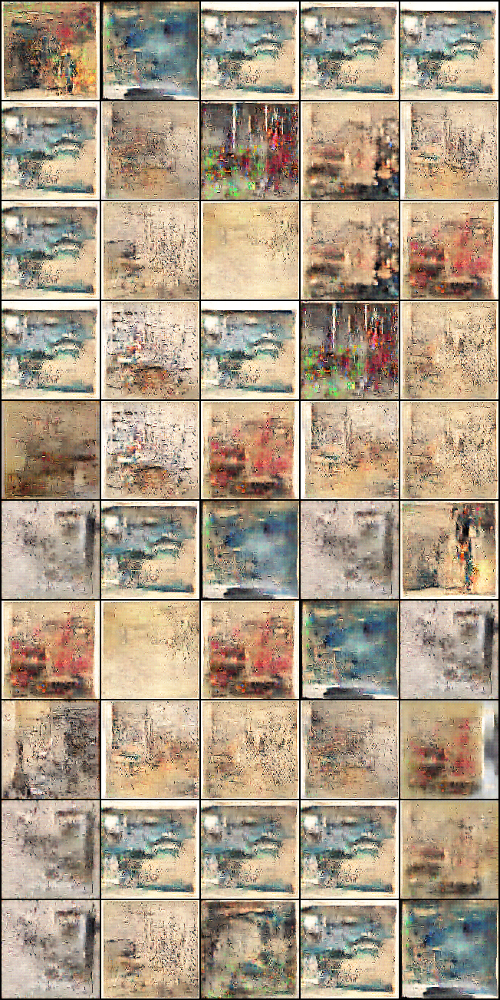

In [73]:
I('./generated/sample_450.png')

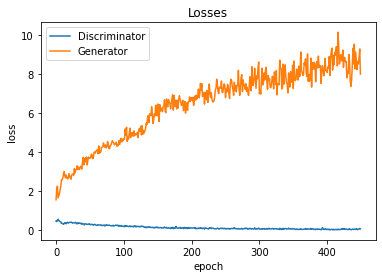

In [74]:
plt.plot(D_loss_plot, '-')
plt.plot(G_loss_plot, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');